## Name- Ranjan Pratap Singh                                                      DS2307

## Temperature Forecast Project using ML
### Project Description
This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

Attribute Information:

For more information, read [Cho et al, 2020].

1. station - used weather station number: 1 to 25

2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')

3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6

4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9

5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5

6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100

7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5

8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6

9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9

10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4

11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97

12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97

13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98

14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97

15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7

16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6

17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8

18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7

19. lat - Latitude (Â°): 37.456 to 37.645

20. lon - Longitude (Â°): 126.826 to 127.135

21. DEM - Elevation (m): 12.4 to 212.3

22. Slope - Slope (Â°): 0.1 to 5.2

23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9

24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9

25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

You have to build separate models that can predict the minimum temperature for the next day and the maximum temperature for the next day based on the details provided in the dataset.


### Importing the libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings 
warnings.filterwarnings('ignore')


### Importing Dataset

In [2]:
df = pd.read_csv(r"C:\Users\RANJAN\Downloads\temperature.csv")

### Exploratory Data Analysis(EDA)  ----->

In [3]:
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


Our dataset of Temperature Forecast Project  having 7752 rows and 25 columns, all the columns are explained in project decription.Next_Tmax,Next_Tmin are our two target variable which are numerical and  continuous in nature so we will use regression models in both target variable to train, test and predict the data.  

In [4]:
df.duplicated().sum()

0

here we can see that there are no duplicated values in our dataset 

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


here we can see that our dataset contain two dtpyes i.e. object and float and there are  null values in our data set  we will further check later for white spaces 

In [6]:
df['station'] = df['station'].astype('object')
df['Date'] = pd.to_datetime(df['Date'])

In [7]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   station           7750 non-null   object        
 1   Date              7750 non-null   datetime64[ns]
 2   Present_Tmax      7682 non-null   float64       
 3   Present_Tmin      7682 non-null   float64       
 4   LDAPS_RHmin       7677 non-null   float64       
 5   LDAPS_RHmax       7677 non-null   float64       
 6   LDAPS_Tmax_lapse  7677 non-null   float64       
 7   LDAPS_Tmin_lapse  7677 non-null   float64       
 8   LDAPS_WS          7677 non-null   float64       
 9   LDAPS_LH          7677 non-null   float64       
 10  LDAPS_CC1         7677 non-null   float64       
 11  LDAPS_CC2         7677 non-null   float64       
 12  LDAPS_CC3         7677 non-null   float64       
 13  LDAPS_CC4         7677 non-null   float64       
 14  LDAPS_PPT1        7677 n

In [9]:
#  checking the values counts of each column
for i in df.columns:
    print(df[i].value_counts())
    print("\n")

1.0     310
14.0    310
24.0    310
23.0    310
22.0    310
21.0    310
20.0    310
19.0    310
18.0    310
17.0    310
16.0    310
15.0    310
13.0    310
2.0     310
12.0    310
11.0    310
10.0    310
9.0     310
8.0     310
7.0     310
6.0     310
5.0     310
4.0     310
3.0     310
25.0    310
Name: station, dtype: int64


2013-06-30    25
2016-07-18    25
2016-07-25    25
2016-07-24    25
2016-07-23    25
              ..
2014-09-08    25
2014-08-08    25
2014-07-08    25
2014-06-08    25
2017-08-30    25
Name: Date, Length: 310, dtype: int64


31.4    112
29.4    111
29.1    108
29.7    107
31.9    105
       ... 
36.9      1
21.2      1
20.1      1
36.4      1
20.3      1
Name: Present_Tmax, Length: 167, dtype: int64


24.0    161
23.8    153
23.1    144
23.5    143
23.3    142
       ... 
13.6      1
14.2      1
29.1      1
29.7      1
15.0      1
Name: Present_Tmin, Length: 155, dtype: int64


19.794666    2
71.658089    2
77.030350    2
98.524734    2
51.810596    2
        

here we can see that there are no white spaces but there are null values so we will do various steps to fill these 

In [10]:
df = df[~df[['Next_Tmax', 'Next_Tmin']].isnull().any(axis=1)]


In [11]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        60
Present_Tmin        60
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax            0
Next_Tmin            0
dtype: int64

In [12]:
df[['station','Date','Present_Tmax','Present_Tmin']] = df[['station','Date','Present_Tmin','Present_Tmax']].fillna(df[['station','Date','Present_Tmax','Present_Tmin']].mode().iloc[0])

In [13]:
df[['LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']] = df[['LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']].fillna(df[['LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']].mean())

In [14]:
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

here we can see that there are no null values in the dataset

In [15]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,...,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000,7725.000000
mean,13.005049,23.230654,29.782227,56.741402,88.369140,29.616253,23.511807,7.096739,62.468599,0.368482,...,0.484298,0.277121,0.269440,37.544755,126.991370,61.926856,1.258725,5342.066031,30.274887,22.932220
std,7.215687,2.406524,2.962665,14.583630,7.164028,2.932271,2.333987,2.171835,33.556339,0.261052,...,1.752597,1.152456,1.199982,0.050386,0.079347,54.331701,1.371331,429.235277,3.128010,2.487613
min,1.000000,11.300000,20.000000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,21.700000,27.800000,46.045017,84.291199,27.696185,22.114277,5.686496,37.452979,0.148229,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,23.400000,29.900000,55.266701,89.699196,29.664030,23.733589,6.564141,57.299645,0.319678,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5437.534180,30.500000,23.100000
75%,19.000000,24.900000,32.000000,66.996681,93.704353,31.687106,25.135301,7.996899,83.897461,0.571547,...,0.024035,0.009649,0.000703,37.577600,127.042000,59.832400,1.767800,5728.624512,32.600000,24.600000
max,25.000000,29.900000,37.600000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In description we have count,mean, standard deviation(STD) , minimum(min), 25%,50%(median),75%,maximum(max)

as we can see that there is no negative value so our description of dataset is valid 

number of observations are same in all columns so there is no missing values

if we compare mean with median i.e. 50% we can see some of the data  don't have same so that all  the data is not normally distributed

if we see for outliers we can observe that some coulmn may contain outliers that we will check  later in this model

In [16]:
df['station'] = df['station'].astype('object')

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7725 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   station           7725 non-null   object        
 1   Date              7725 non-null   datetime64[ns]
 2   Present_Tmax      7725 non-null   float64       
 3   Present_Tmin      7725 non-null   float64       
 4   LDAPS_RHmin       7725 non-null   float64       
 5   LDAPS_RHmax       7725 non-null   float64       
 6   LDAPS_Tmax_lapse  7725 non-null   float64       
 7   LDAPS_Tmin_lapse  7725 non-null   float64       
 8   LDAPS_WS          7725 non-null   float64       
 9   LDAPS_LH          7725 non-null   float64       
 10  LDAPS_CC1         7725 non-null   float64       
 11  LDAPS_CC2         7725 non-null   float64       
 12  LDAPS_CC3         7725 non-null   float64       
 13  LDAPS_CC4         7725 non-null   float64       
 14  LDAPS_PPT1        7725 n

### Data Visualization --->

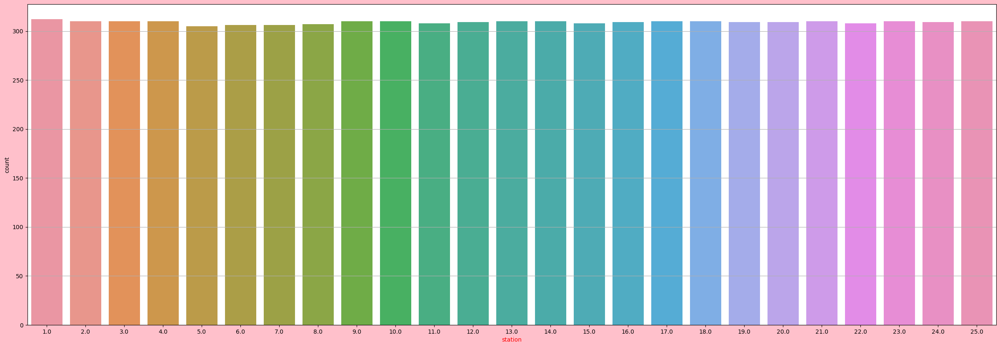

1.0     312
10.0    310
23.0    310
21.0    310
18.0    310
17.0    310
14.0    310
2.0     310
13.0    310
9.0     310
4.0     310
3.0     310
25.0    310
12.0    309
16.0    309
19.0    309
20.0    309
24.0    309
11.0    308
15.0    308
22.0    308
8.0     307
7.0     306
6.0     306
5.0     305
Name: station, dtype: int64

In [168]:
plt.figure(figsize=(30,10), facecolor="pink")
sns.countplot(x='station' , data = df )
plt.xlabel('station',color = 'r')
plt.grid(axis ='y')
plt.show()
df['station'].value_counts()

here we can see that all station are in equal numbers

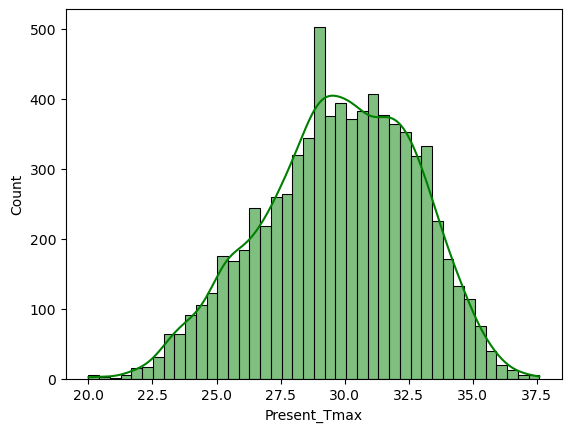

In [181]:
sns.histplot(x='Present_Tmax', data=df, kde=True, color='green')
plt.show()

here we can see that dataset is normally distributed

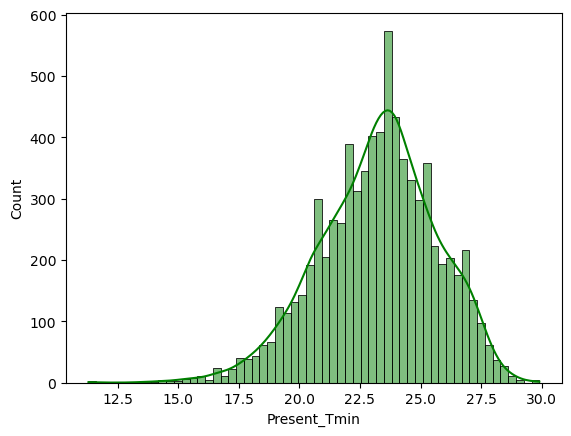

In [182]:
sns.histplot(x='Present_Tmin', data=df, kde=True, color='green')
plt.show()

here we can see that dataset is negatively distributed

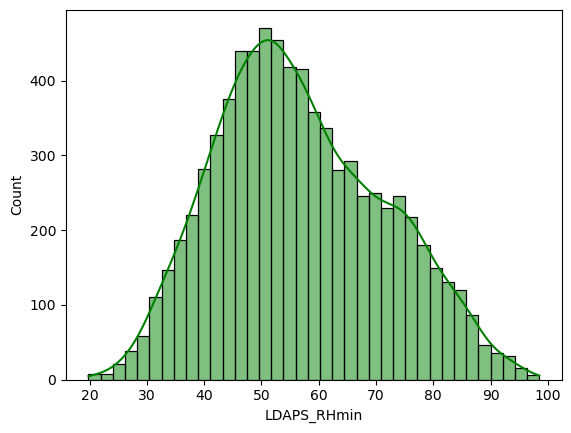

In [183]:
sns.histplot(x='LDAPS_RHmin', data=df, kde=True, color='green')
plt.show()

here we can see that dataset is normally distributed

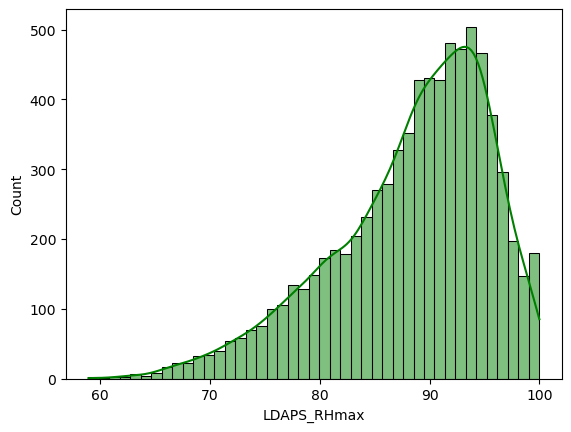

In [184]:
sns.histplot(x='LDAPS_RHmax', data=df, kde=True, color='green')
plt.show()

here we can see that dataset is negatively distributed

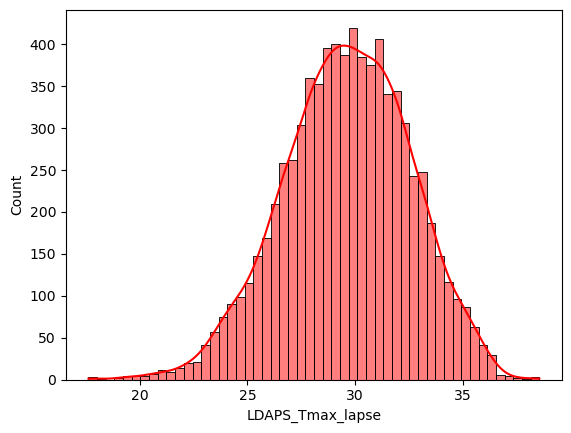

In [186]:
sns.histplot(x='LDAPS_Tmax_lapse', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is normally distributed

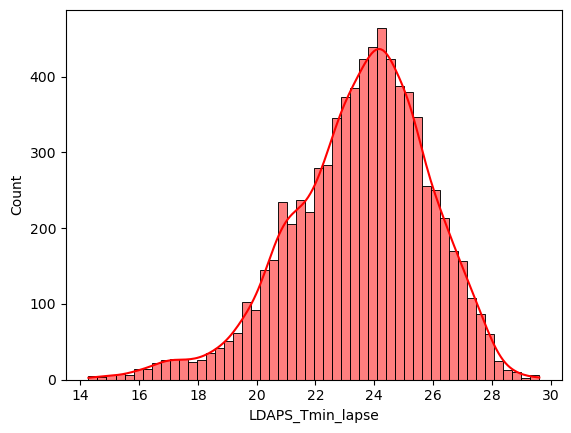

In [187]:
sns.histplot(x='LDAPS_Tmin_lapse', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is normally distributed

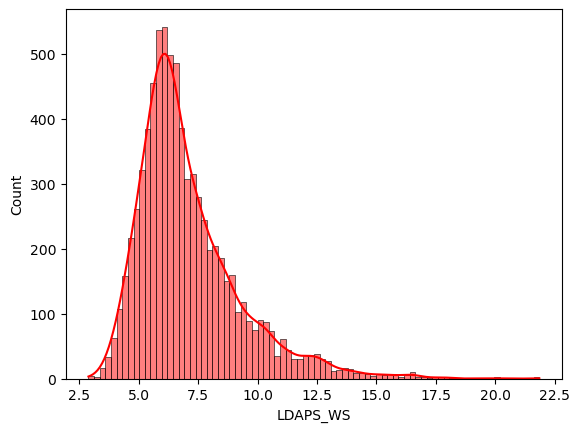

In [188]:
sns.histplot(x='LDAPS_WS', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is positively distributed

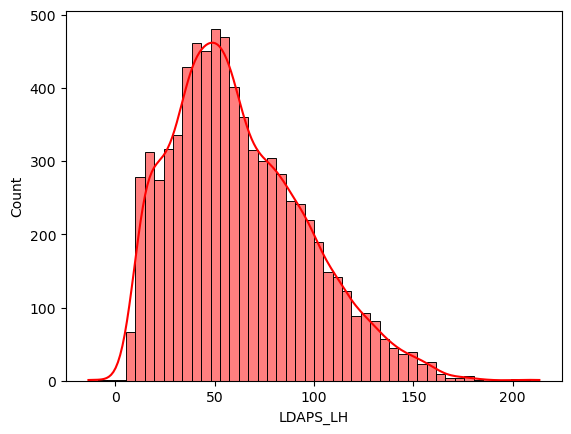

In [189]:
sns.histplot(x='LDAPS_LH', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is normally distributed

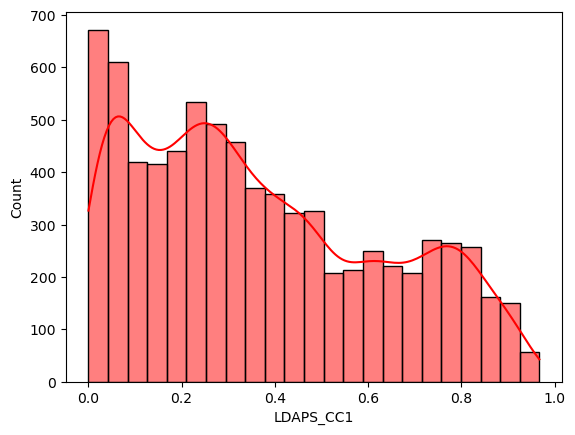

In [192]:
sns.histplot(x='LDAPS_CC1', data=df, kde=True, color='red')
plt.show()

here we can see that dataset seems normally distributed

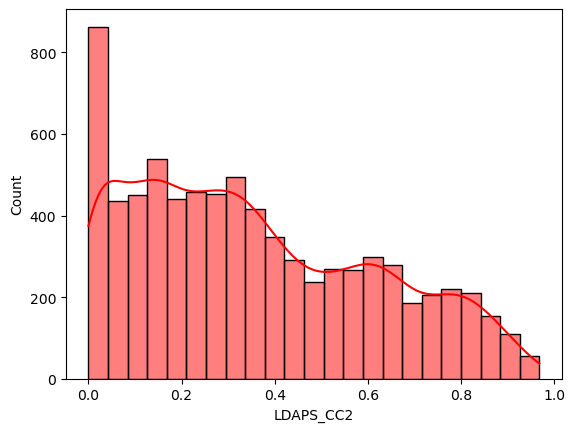

In [193]:
sns.histplot(x='LDAPS_CC2', data=df, kde=True, color='red')
plt.show()

here we can see that dataset looks positively distributed

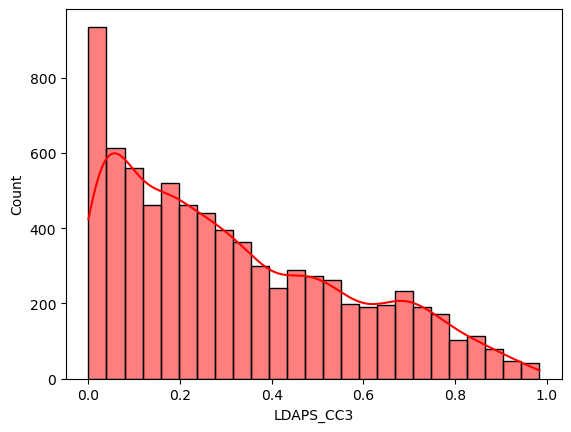

In [194]:
sns.histplot(x='LDAPS_CC3', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is positevely distributed

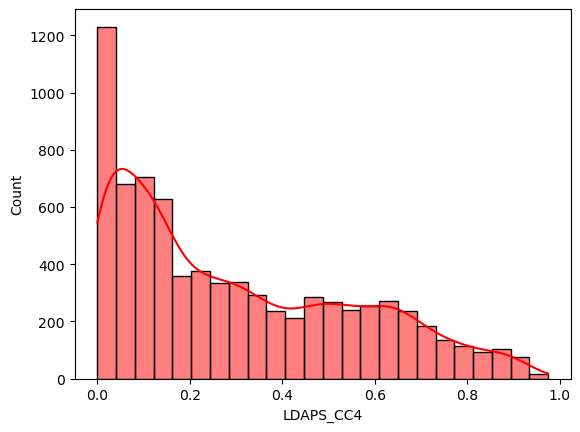

In [198]:
sns.histplot(x='LDAPS_CC4', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is positevely distributed

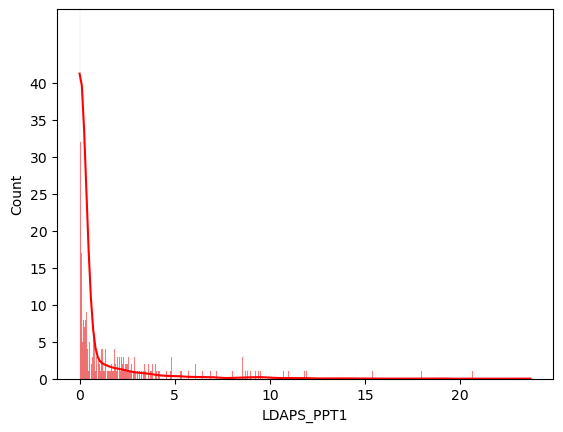

In [203]:
sns.histplot(x='LDAPS_PPT1', data=df, kde=True, color='red')
plt.ylim(0.00000, 50)
plt.yticks(range(0, 41, 5))
plt.show()

here we can see that dataset is positevely distributed

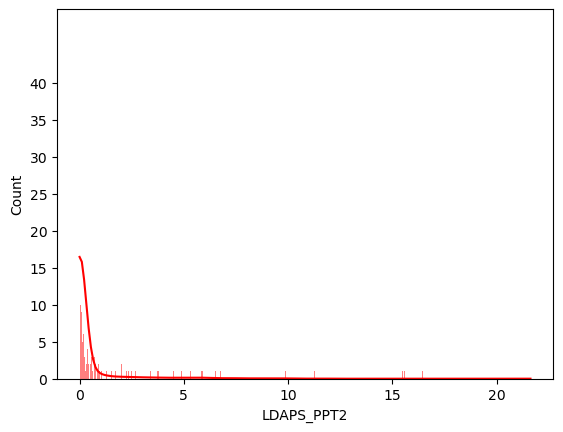

In [204]:
sns.histplot(x='LDAPS_PPT2', data=df, kde=True, color='red')
plt.ylim(0.00000, 40)
plt.yticks(range(0, 41, 5))
plt.show()

here we can see that dataset is positevely distributed

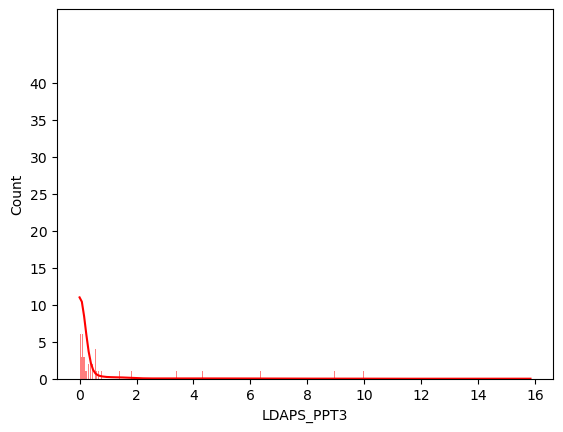

In [205]:
sns.histplot(x='LDAPS_PPT3', data=df, kde=True, color='red')
plt.ylim(0.00000, 50)
plt.yticks(range(0, 41, 5))
plt.show()

here we can see that dataset is positevely distributed

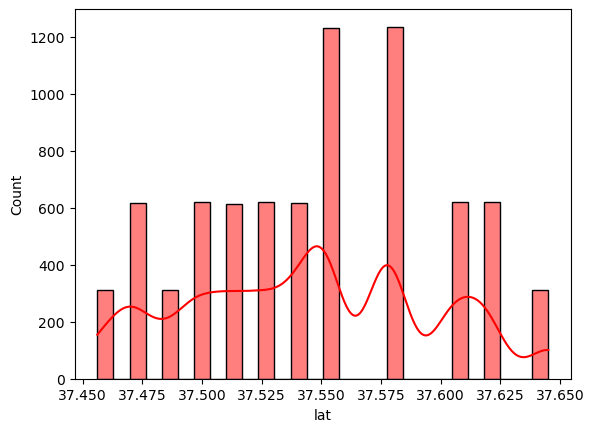

In [18]:
sns.histplot(x='lat', data=df, kde=True, color='red')
plt.show()

here  we can see that there is no significance relationship 

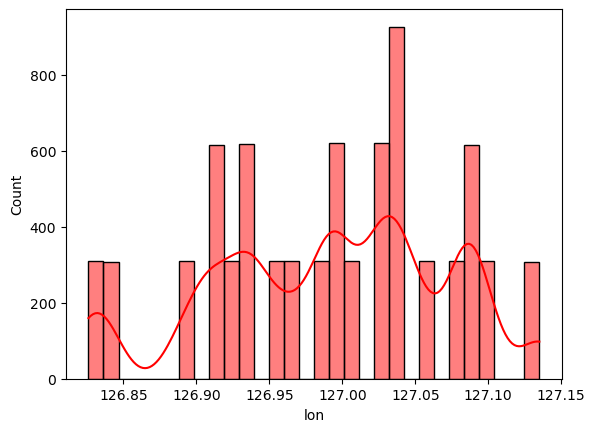

In [18]:
sns.histplot(x='lon', data=df, kde=True, color='red')
plt.show()

here we can see that dataset is positevely distributed

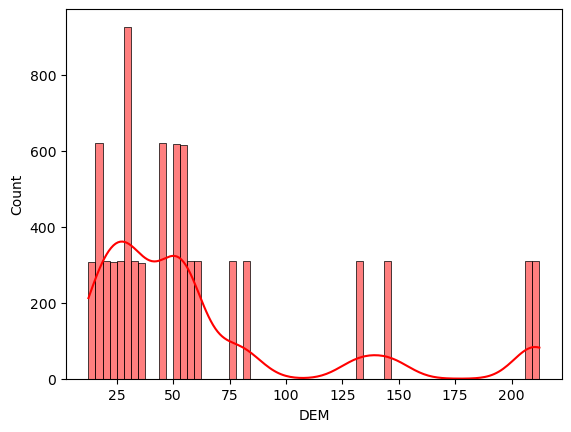

In [19]:
sns.histplot(x='DEM', data=df, kde=True, color='red')
plt.show()

here we can see that data is positively distributed

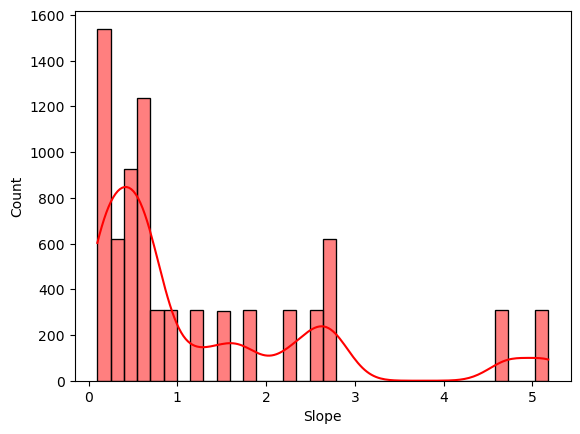

In [20]:
sns.histplot(x='Slope', data=df, kde=True, color='red')
plt.show()

here we can see that data is positively distributed

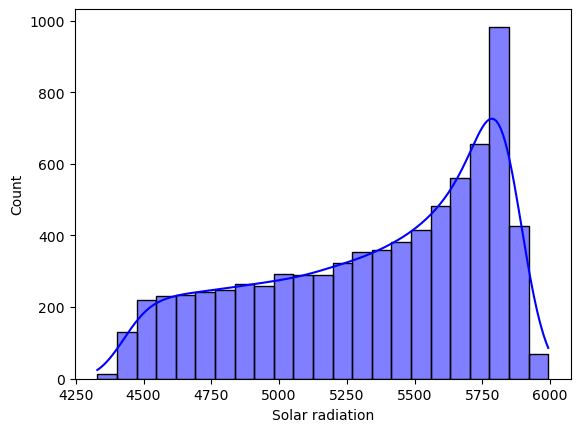

In [21]:
sns.histplot(x='Solar radiation', data=df, kde=True, color='blue')
plt.show()

here we can see that data is negatively distributed

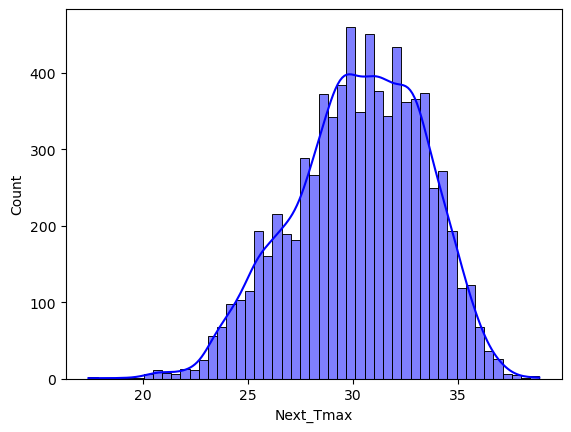

In [22]:
sns.histplot(x='Next_Tmax', data=df, kde=True, color='blue')
plt.show()

here we can see that data is negatively distributed

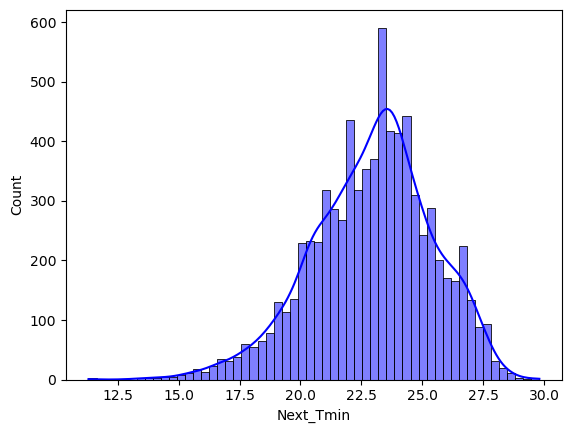

In [23]:
sns.histplot(x='Next_Tmin', data=df, kde=True, color='blue')
plt.show()

here we can see that data is negatively distributed

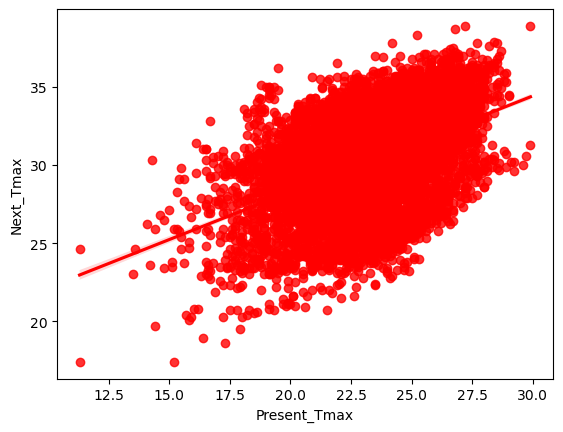

In [34]:
sns.regplot(y='Next_Tmax', x='Present_Tmax', data=df,color='red')
plt.show()

here we can see that there is positive relationship 

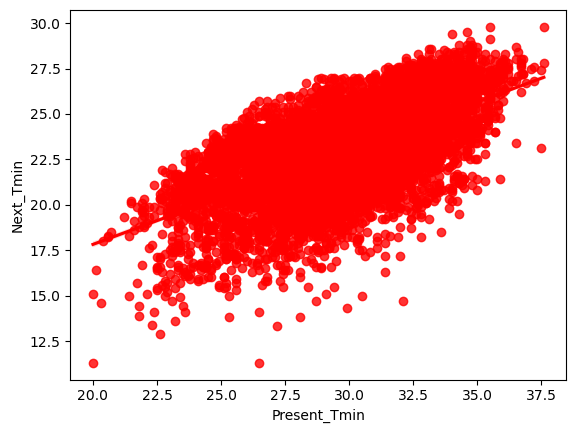

In [38]:
sns.regplot(y='Next_Tmin', x='Present_Tmin', data=df,color='red')
plt.show()

here we can see that there is positive relationship 

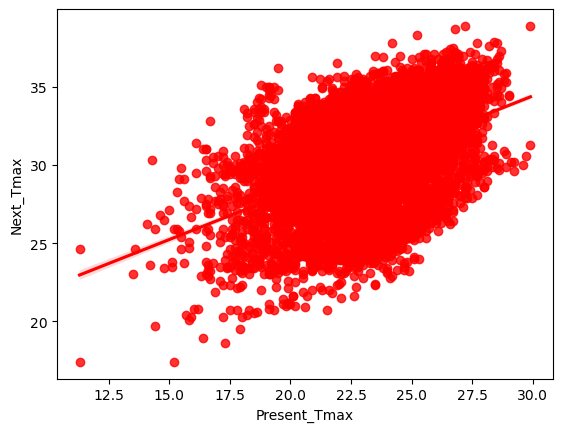

In [36]:
sns.regplot(y='Next_Tmax', x='Present_Tmax', data=df,color='red')
plt.show()

here we can see that there is positive relationship 

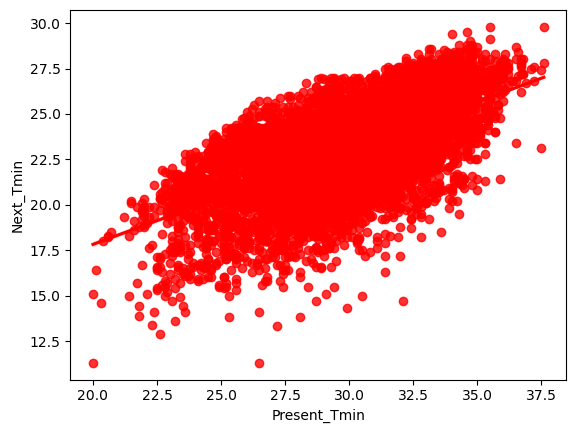

In [37]:
sns.regplot(y='Next_Tmin', x='Present_Tmin', data=df,color='red')
plt.show()

here we can see that there is positive relationship 

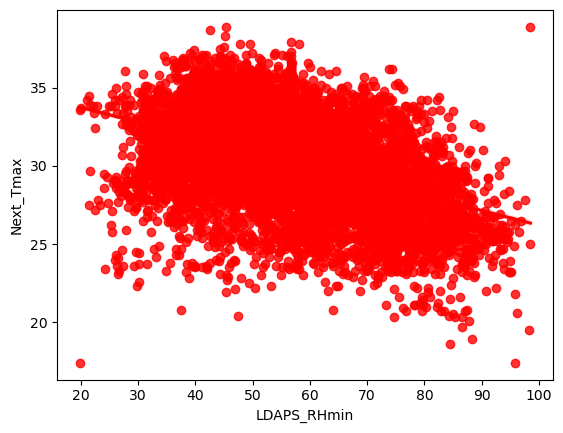

In [39]:
sns.regplot(y='Next_Tmax', x='LDAPS_RHmin', data=df,color='red')
plt.show()

here we can see that there is approximately negative  relationship 

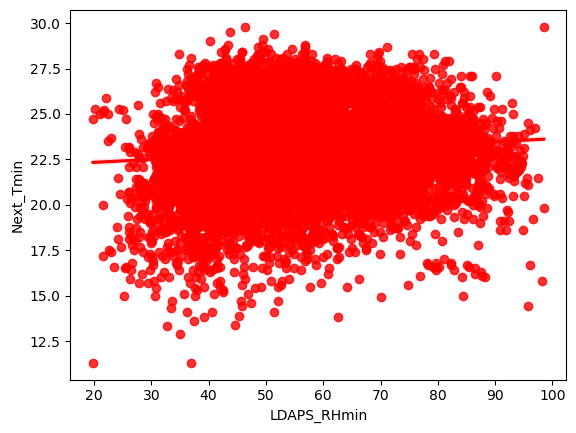

In [40]:
sns.regplot(y='Next_Tmin', x='LDAPS_RHmin', data=df,color='red')
plt.show()

here we can see that there is no significantly relationship between them

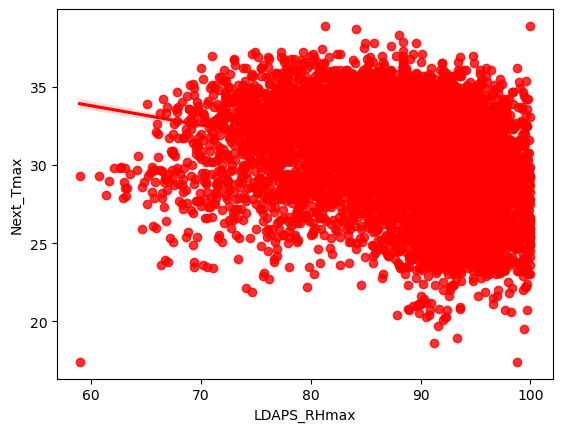

In [41]:
sns.regplot(y='Next_Tmax', x='LDAPS_RHmax', data=df,color='red')
plt.show()

here we can see that there is very less negative relationship 

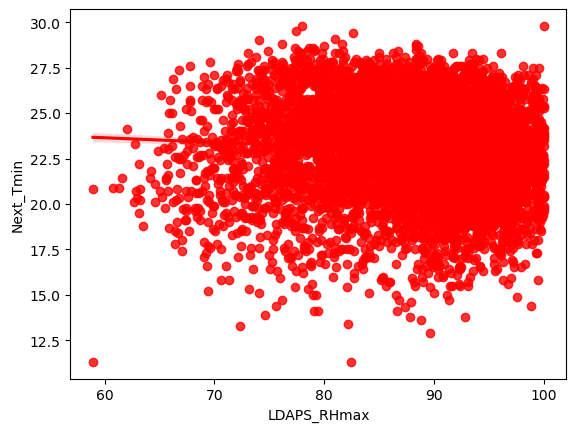

In [42]:
sns.regplot(y='Next_Tmin', x='LDAPS_RHmax', data=df,color='red')
plt.show()

here we can see that there is no significant relationship between them

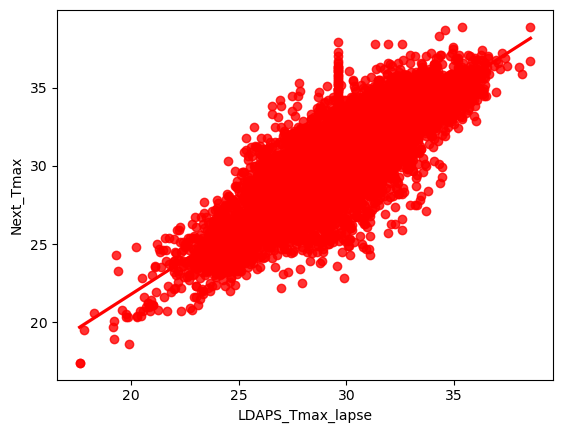

In [47]:
sns.regplot(y='Next_Tmax', x='LDAPS_Tmax_lapse', data=df,color='red')
plt.show()


here we can see that there is positive relationship 

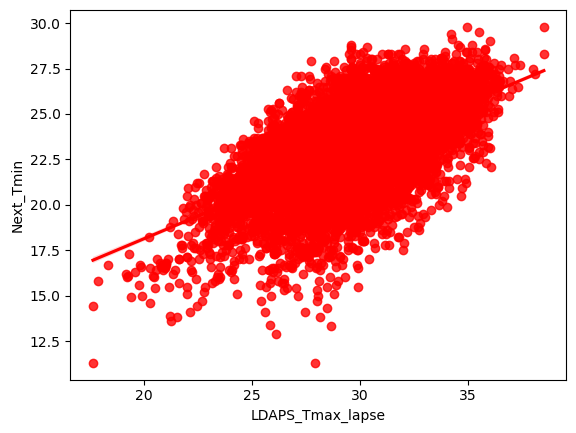

In [48]:
sns.regplot(y='Next_Tmin', x='LDAPS_Tmax_lapse', data=df,color='red')
plt.show()


here we can see that there is positive relationship 

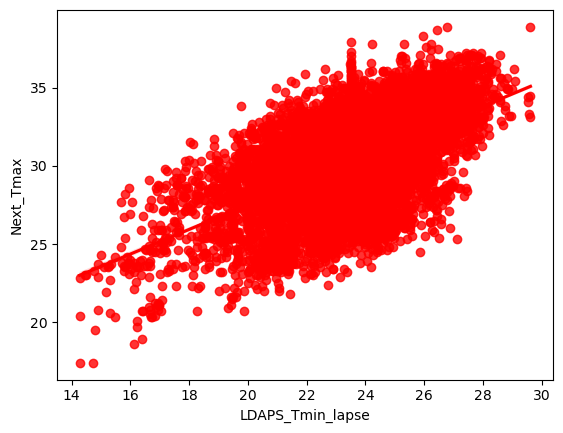

In [49]:
sns.regplot(y='Next_Tmax', x='LDAPS_Tmin_lapse', data=df,color='red')
plt.show()


here we can see that there is positive relationship 

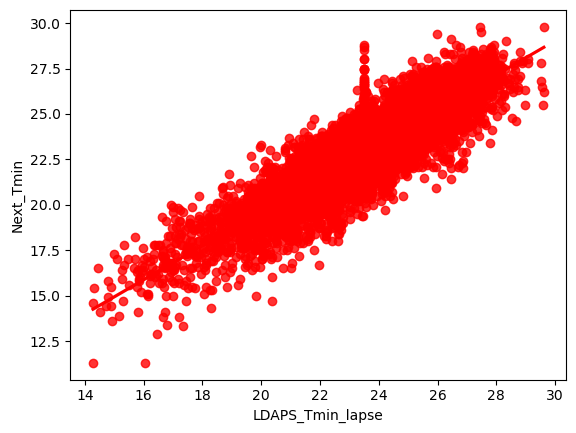

In [50]:
sns.regplot(y='Next_Tmin', x='LDAPS_Tmin_lapse', data=df,color='red')
plt.show()


here we can see that there is positive relationship 

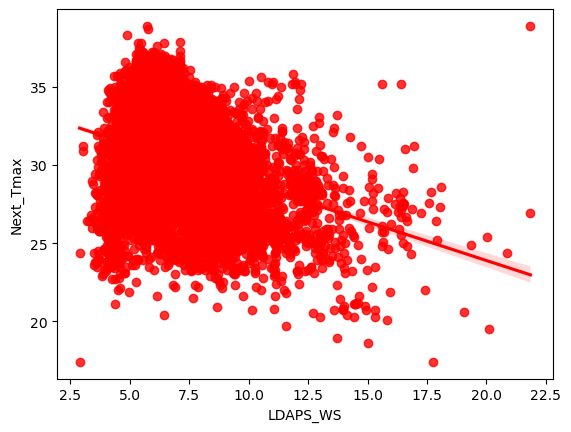

In [51]:
sns.regplot(y='Next_Tmax', x='LDAPS_WS', data=df,color='red')
plt.show()


here we can see that there is negative relationship 

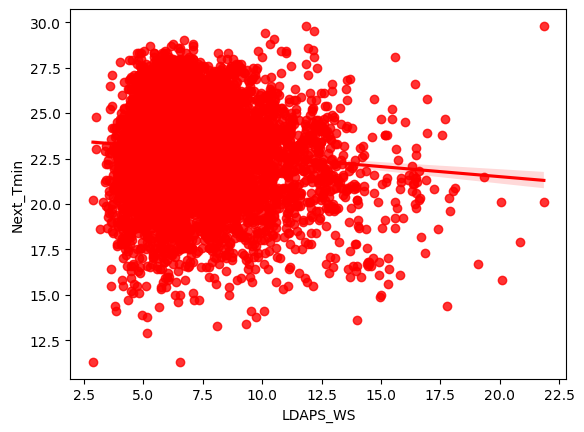

In [52]:
sns.regplot(y='Next_Tmin', x='LDAPS_WS', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

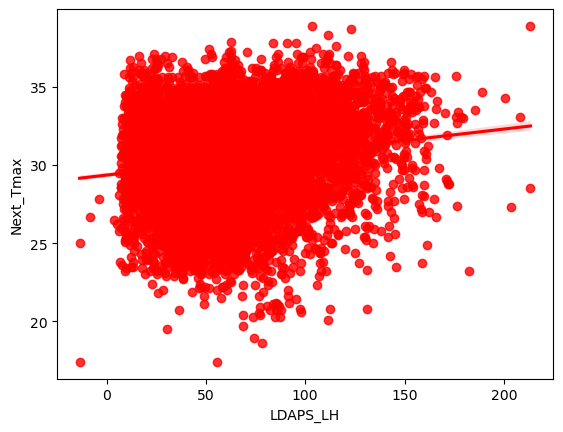

In [53]:
sns.regplot(y='Next_Tmax', x='LDAPS_LH', data=df,color='red')
plt.show()


here we can see that there is very slightly positive relationship 

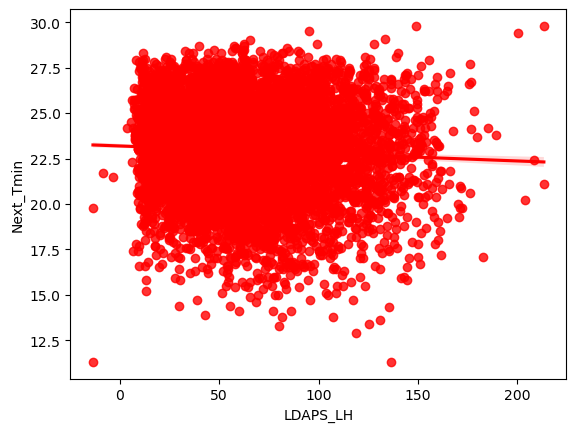

In [54]:
sns.regplot(y='Next_Tmin', x='LDAPS_LH', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

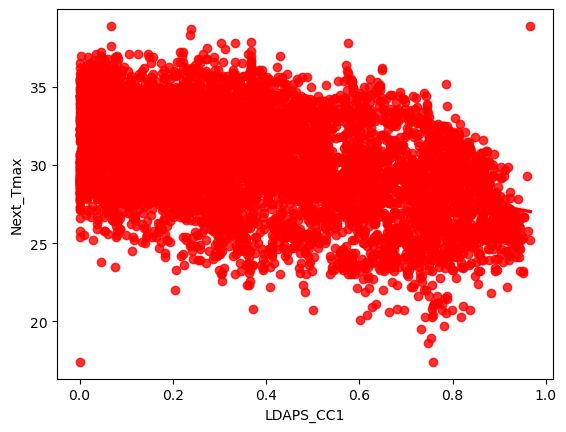

In [55]:
sns.regplot(y='Next_Tmax', x='LDAPS_CC1', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

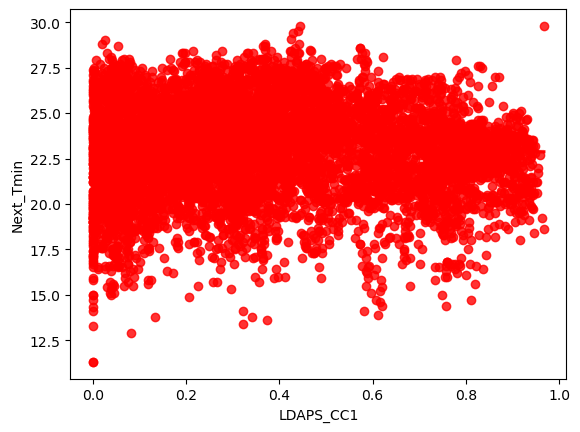

In [56]:
sns.regplot(y='Next_Tmin', x='LDAPS_CC1', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

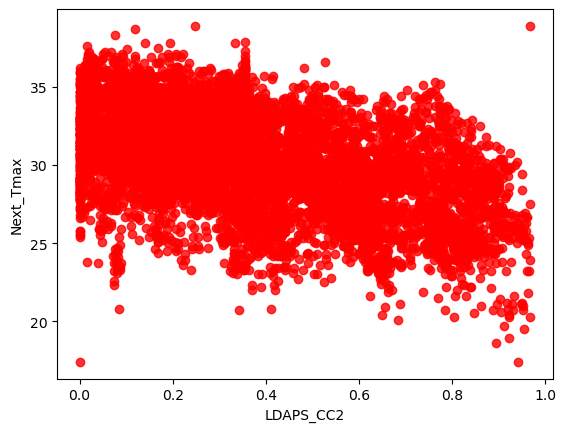

In [57]:
sns.regplot(y='Next_Tmax', x='LDAPS_CC2', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

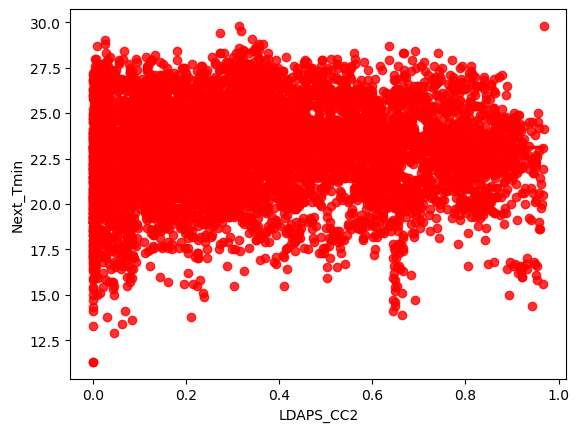

In [58]:
sns.regplot(y='Next_Tmin', x='LDAPS_CC2', data=df,color='red')
plt.show()


here we can see that there is no significant 

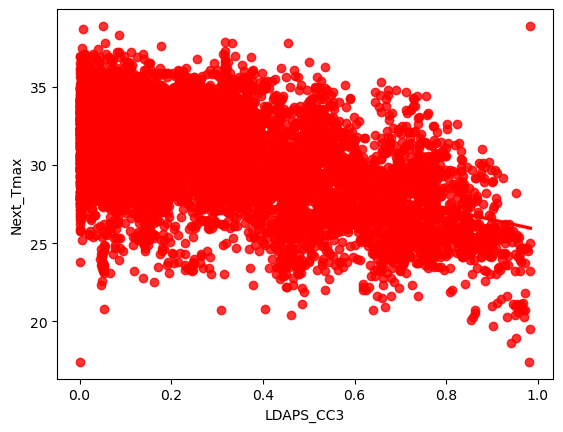

In [59]:
sns.regplot(y='Next_Tmax', x='LDAPS_CC3', data=df,color='red')
plt.show()


here we can see that there is negative realtionship 

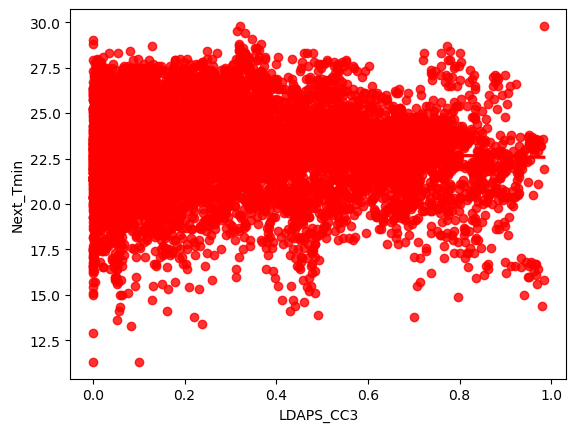

In [60]:
sns.regplot(y='Next_Tmin', x='LDAPS_CC3', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

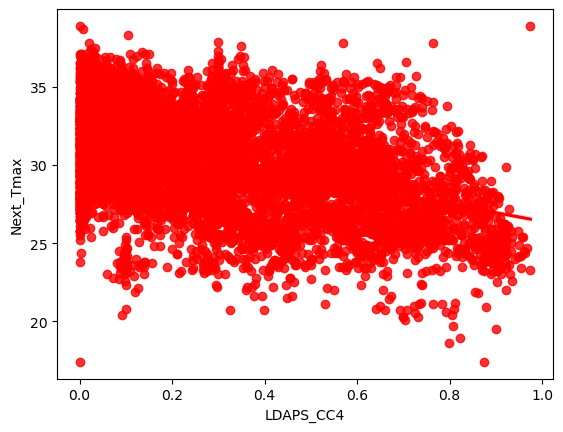

In [61]:
sns.regplot(y='Next_Tmax', x='LDAPS_CC4', data=df,color='red')
plt.show()


here we can see that there is slightly negative relationship

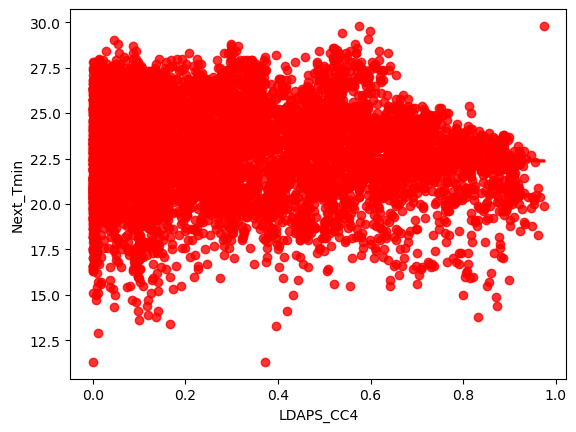

In [62]:
sns.regplot(y='Next_Tmin', x='LDAPS_CC4', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

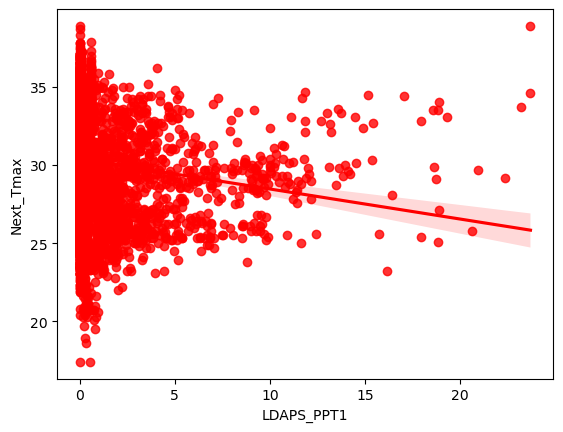

In [63]:
sns.regplot(y='Next_Tmax', x='LDAPS_PPT1', data=df,color='red')
plt.show()


here we can see that there is slightly negative relationship 

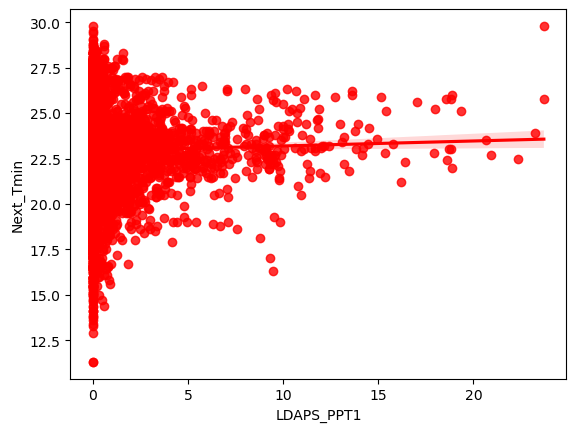

In [64]:
sns.regplot(y='Next_Tmin', x='LDAPS_PPT1', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

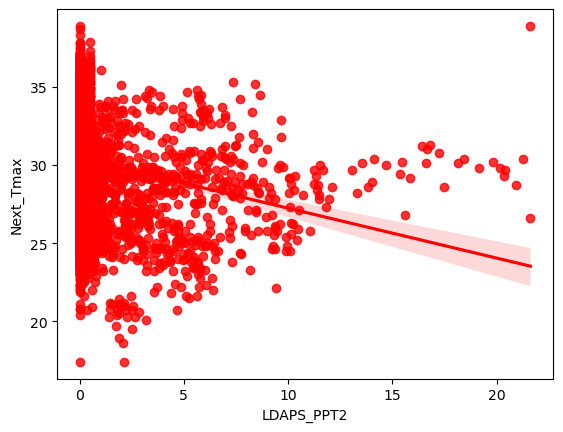

In [65]:
sns.regplot(y='Next_Tmax', x='LDAPS_PPT2', data=df,color='red')
plt.show()


here we can see that there is negative relationship

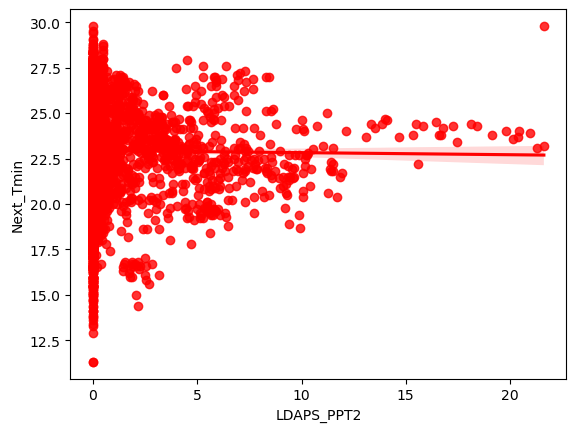

In [66]:
sns.regplot(y='Next_Tmin', x='LDAPS_PPT2', data=df,color='red')
plt.show()


here we can see that there is no significant relationship

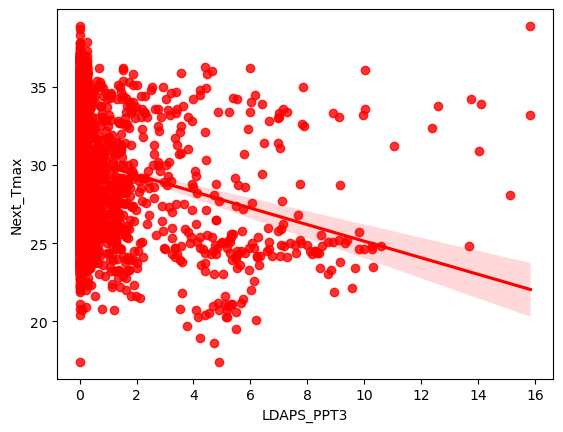

In [67]:
sns.regplot(y='Next_Tmax', x='LDAPS_PPT3', data=df,color='red')
plt.show()


here we can see there is negative relationship 

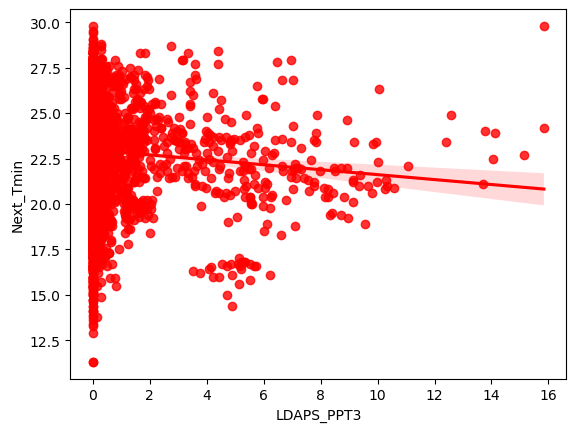

In [68]:
sns.regplot(y='Next_Tmin', x='LDAPS_PPT3', data=df,color='red')
plt.show()


here we can see there is bery slightly negative relationship 

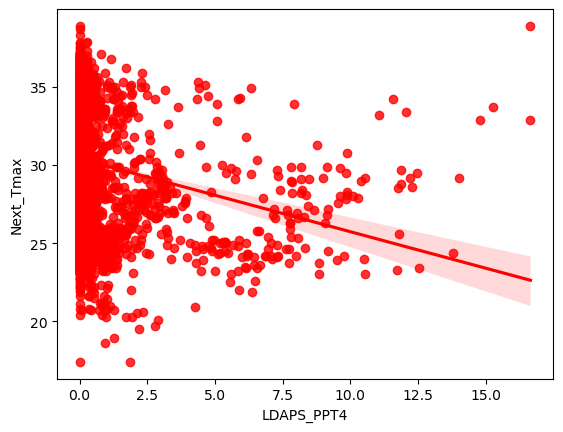

In [69]:
sns.regplot(y='Next_Tmax', x='LDAPS_PPT4', data=df,color='red')
plt.show()


here we can see there is negative relationship 

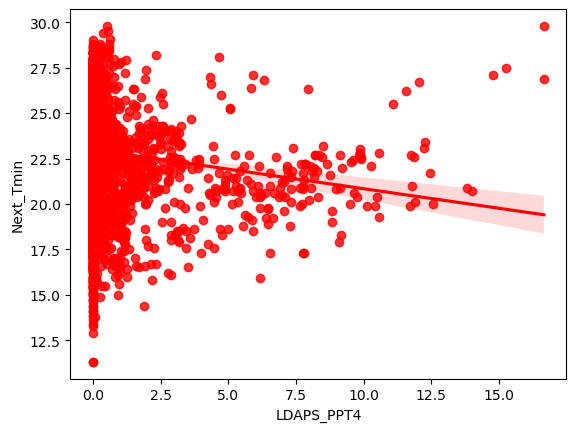

In [70]:
sns.regplot(y='Next_Tmin', x='LDAPS_PPT4', data=df,color='red')
plt.show()


here we can see there is bery slightly negative relationship 

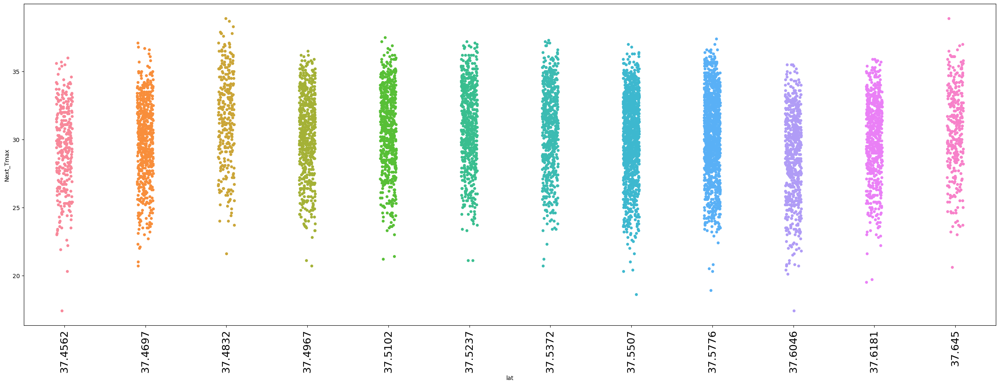

In [103]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmax', x='lat', data=df)
plt.show()


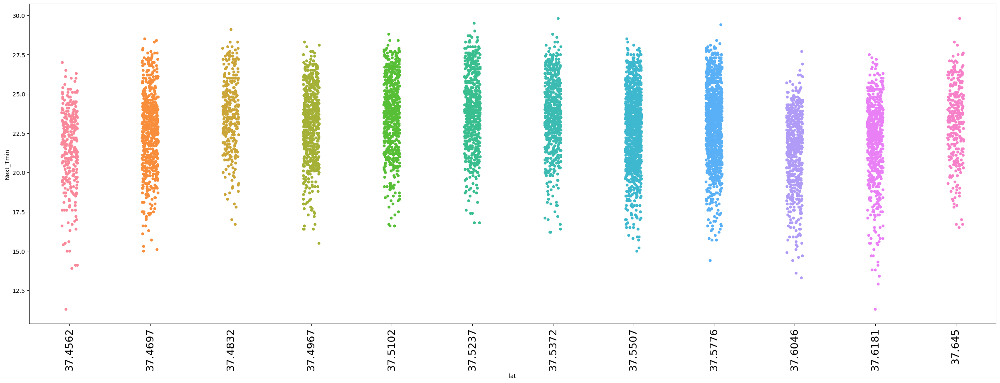

In [104]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmin', x='lat', data=df)
plt.show()


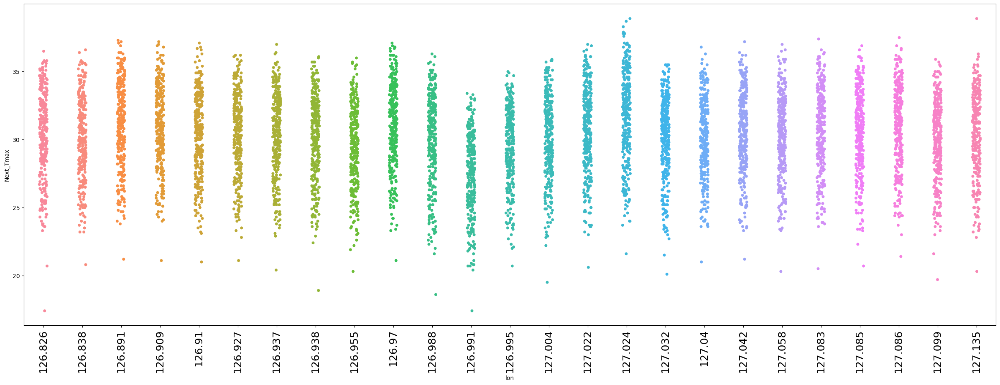

In [105]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmax', x='lon', data=df)
plt.show()


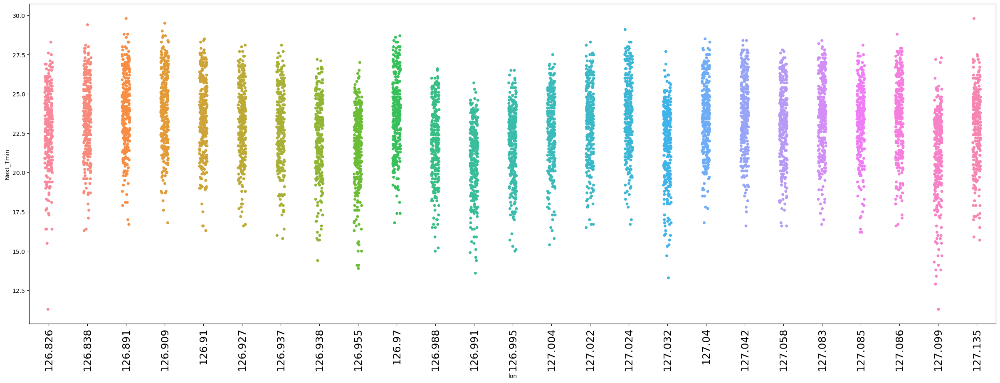

In [106]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmin', x='lon', data=df)
plt.show()


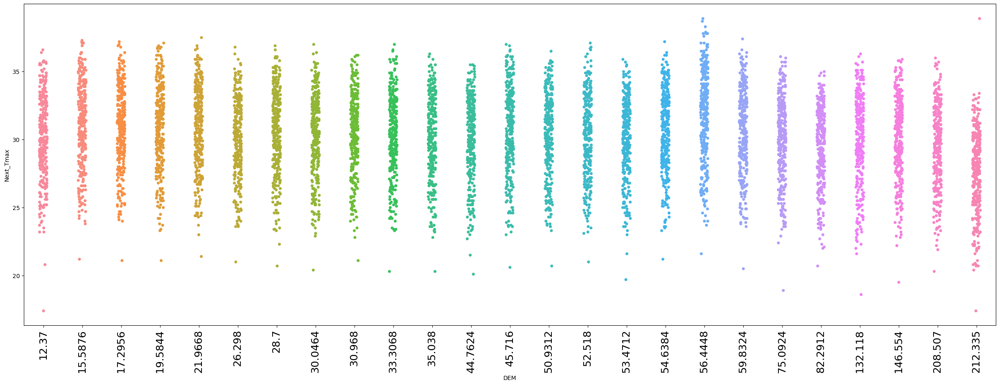

In [107]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmax', x='DEM', data=df)
plt.show()


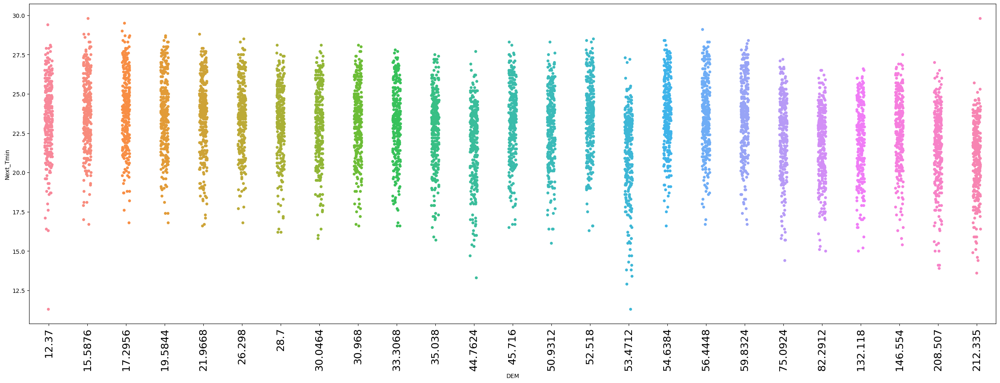

In [108]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmin', x='DEM', data=df)
plt.show()


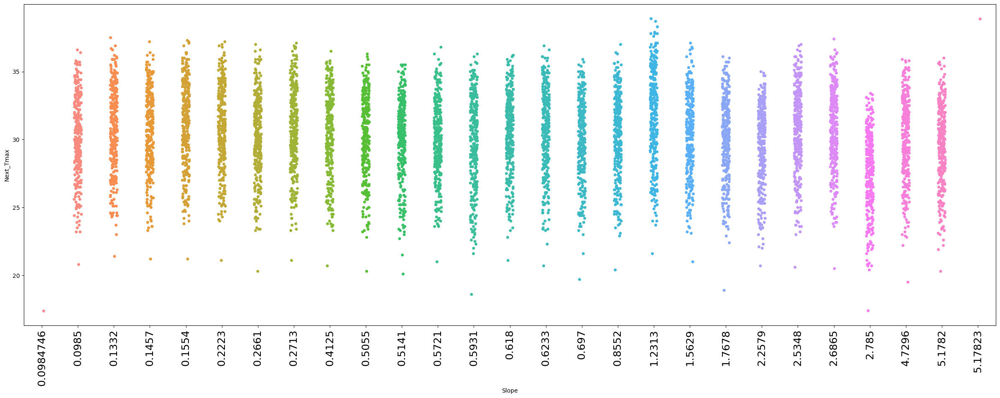

In [109]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmax', x='Slope', data=df)
plt.show()


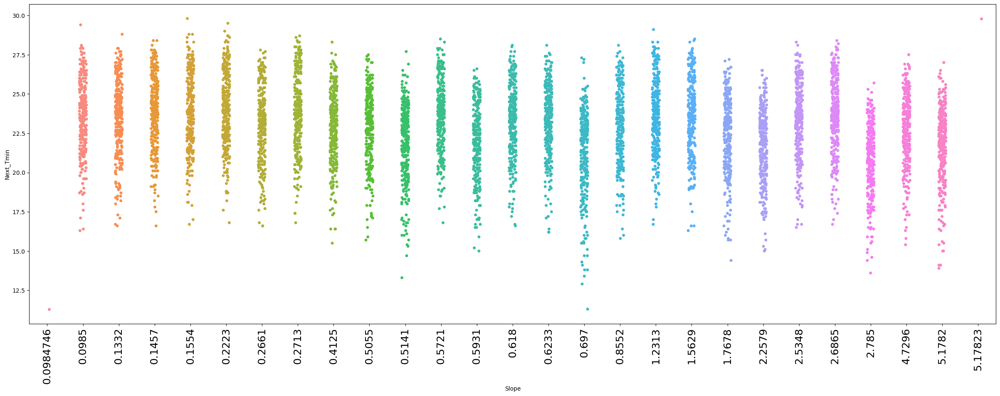

In [101]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90,fontsize=18 )
sns.stripplot(y='Next_Tmin', x='Slope', data=df)
plt.show()


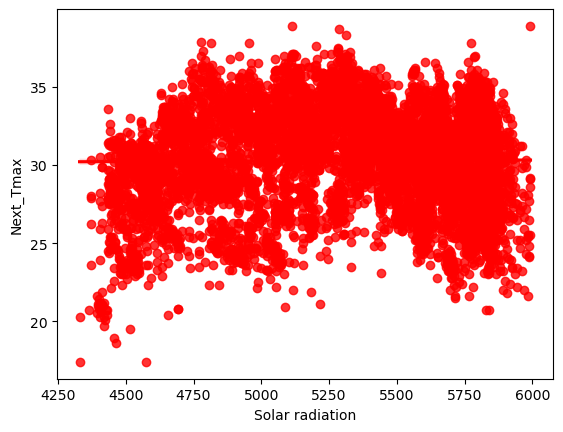

In [79]:
sns.regplot(y='Next_Tmax', x='Solar radiation', data=df,color='red')
plt.show()


here we can not see any significant relationship

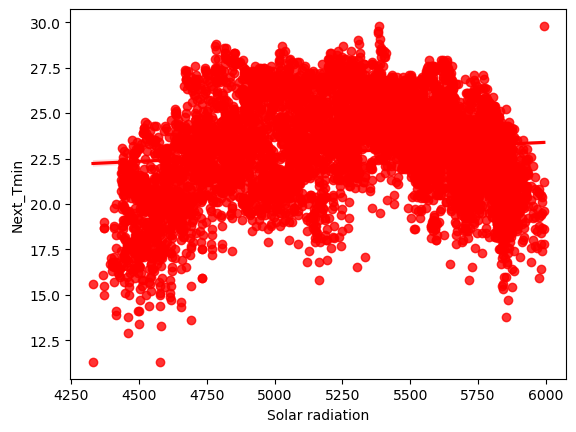

In [80]:
sns.regplot(y='Next_Tmin', x='Solar radiation', data=df,color='red')
plt.show()


here we can not see any significant relationship

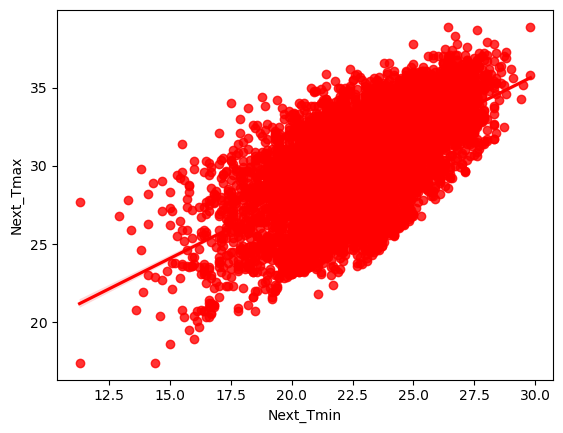

In [81]:
sns.regplot(y='Next_Tmax', x='Next_Tmin', data=df,color='red')
plt.show()


here we can see that there is positive realtionship

<function matplotlib.pyplot.show(close=None, block=None)>

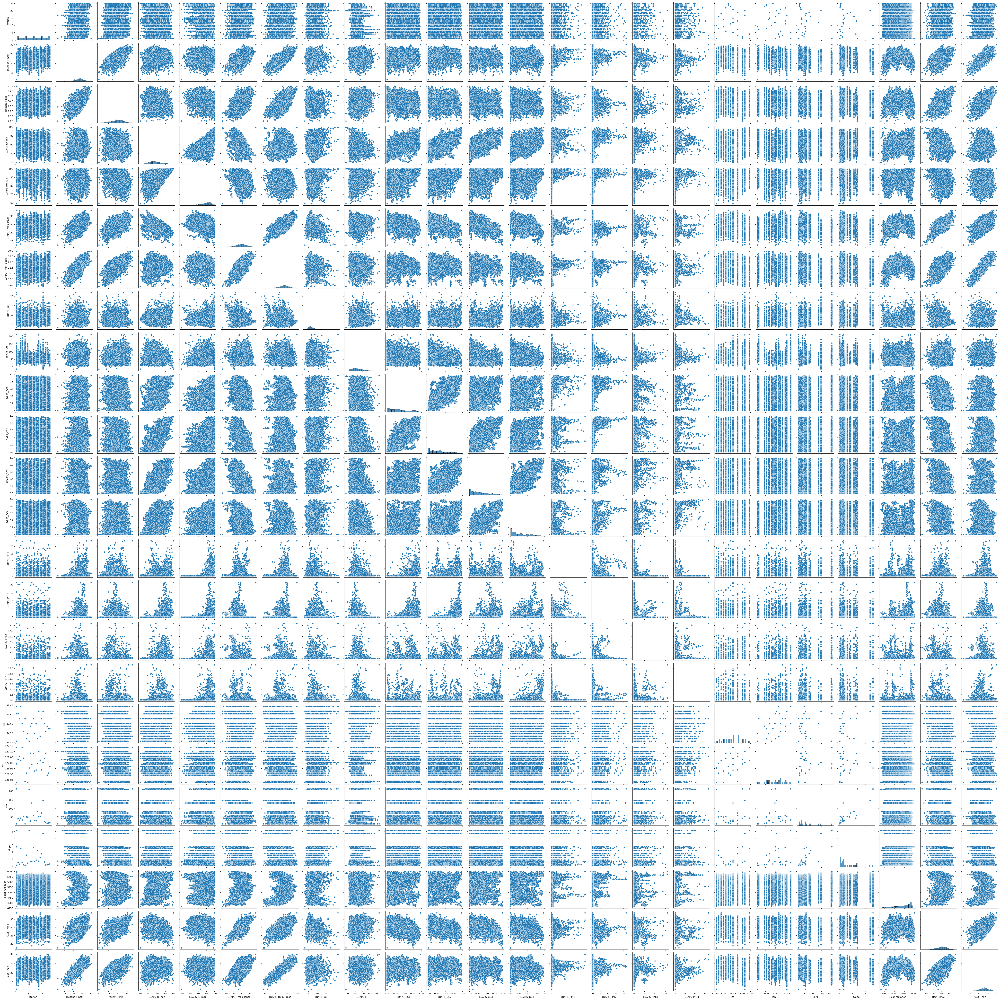

In [110]:
sns.pairplot(data = df)
plt.show

In [190]:
df1.columns

Index(['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

### -- Checking for Outliers

In [169]:
df1 = df.select_dtypes(exclude=['object', 'datetime64[ns]'])
df1.columns

Index(['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

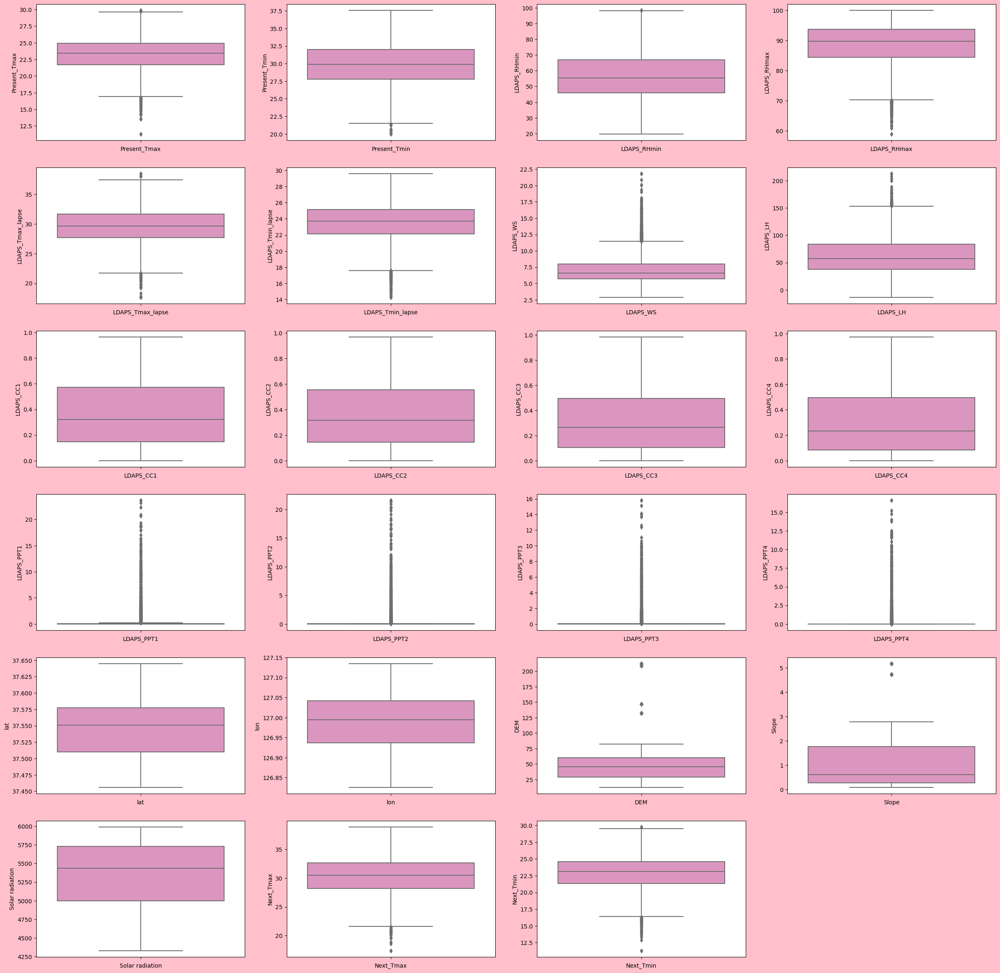

In [21]:
plt.figure(figsize=(30, 30), facecolor="pink")
plotnumber = 1
for i in df1.columns: 
    ax = plt.subplot(6, 4, plotnumber)  
    sns.boxplot(data=df1, y=i, palette='Set2_r')
    ax.set_xlabel(i)
    plotnumber += 1

plt.show()


here we can see that there are outliers present in the data in the 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH','LDAPS_PPT1','LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'DEM', 'Slope','Next_Tmax', 'Next_Tmin'  we will try to rsolve it

In [22]:
from scipy.stats import zscore
z = np.abs(zscore(df1))
z

,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,0.760754,0.365312,0.103841,0.383500,0.525958,0.216327,0.127942,0.208117,0.515389,0.591867,...,0.276350,0.240477,0.224552,1.187800,0.004668,2.768510,1.113060,1.516353,0.375626,0.696383
1,0.677641,0.714867,0.307077,0.312077,0.079955,0.224181,0.646891,0.313855,0.547719,0.405324,...,0.276350,0.240477,0.224552,1.187800,0.512084,0.315940,0.543030,1.228419,0.071972,0.173760
2,0.028818,0.613600,0.552088,0.613599,0.162014,0.451542,0.441367,1.248595,0.609644,0.383122,...,0.276350,0.240477,0.224552,0.651907,0.839780,0.526799,0.723888,1.215006,0.263799,0.389065
3,0.070374,0.748622,0.102751,1.132753,0.030141,0.079539,0.666157,0.097113,0.582719,0.505730,...,0.276350,0.240477,0.224552,1.989656,0.386047,0.298388,0.930598,1.199650,0.455627,0.549872
4,0.552972,0.546089,0.038903,0.249316,0.171318,0.010852,0.627038,1.355925,0.831594,0.412244,...,0.276350,0.240477,0.224552,0.117998,1.810265,0.494934,0.549302,1.205678,0.295771,0.173760
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,2.547679,2.188113,2.057240,1.326055,1.113261,2.029332,0.436443,0.285797,1.296562,1.070580,...,0.276350,0.240477,0.224552,0.149948,1.265038,0.852951,0.804617,2.093980,0.631396,1.942639
7748,2.298340,2.188113,2.242438,1.545901,0.888809,2.047397,0.255063,0.453808,1.274191,1.094242,...,0.276350,0.240477,0.224552,0.417895,1.038171,0.821512,0.755830,2.105491,0.535483,1.661226
7749,2.423009,2.221868,2.318392,1.553053,0.571859,2.137614,0.088652,1.590818,1.224084,1.153053,...,0.276350,0.240477,0.224552,0.417895,0.269346,0.779383,0.720096,2.075269,0.791253,2.224051
7750,4.957949,3.302047,2.533603,4.108689,4.089689,3.958787,1.940494,2.267135,1.411620,1.386325,...,0.276350,0.240477,0.224552,1.757629,2.084278,0.912176,0.846131,2.359105,4.116266,4.676360


In [23]:
np.where(z>3)

(array([  25,   25,   26, ..., 7724, 7724, 7724], dtype=int64),
 array([ 6, 13, 13, ..., 13, 14, 15], dtype=int64))

In [24]:
df2= df[(z<3).all(axis=1)]

In [25]:
print('percentage of dataloss',((df.shape[0]-df2.shape[0])/df.shape[0])*100)

percentage of dataloss 11.080906148867314


In [26]:
Q1 = df1.quantile(0.25)
Q3 = df1.quantile(0.75)
IQR = Q3 - Q1
df3 = df1[~((df1 < (Q1-1.5*IQR)) |(df1> (Q3 + 1.5*IQR))).any(axis=1)]

In [27]:
print('percentage of dataloss',((df1.shape[0]-df3.shape[0])/df1.shape[0])*100)

percentage of dataloss 57.86407766990291


In [28]:
np.where(z>3.2)

(array([  25,   25,   26,   27,   28,   29,   30,   33,   35,   36,   37,
          38,   39,   41,   43,   44,   44,   45,   46,   47,   48,   49,
         150,  151,  152,  153,  154,  155,  156,  157,  158,  159,  160,
         161,  162,  163,  164,  165,  166,  167,  168,  169,  170,  171,
         172,  173,  174,  194,  269,  280,  282,  283,  284,  285,  286,
         288,  289,  290,  292,  294,  295,  296,  297,  298,  299,  304,
         305,  305,  307,  307,  308,  308,  309,  309,  310,  310,  312,
         313,  313,  314,  315,  315,  317,  317,  320,  321,  321,  322,
         323,  323,  324,  324,  325,  326,  327,  328,  329,  331,  337,
         339,  341,  343,  344,  344,  347,  353,  356,  369,  375,  394,
         402,  411,  419,  494,  519,  525,  525,  526,  526,  527,  528,
         528,  529,  530,  531,  531,  532,  532,  533,  533,  534,  534,
         535,  536,  536,  537,  538,  538,  539,  539,  540,  540,  541,
         542,  542,  543,  543,  544, 

In [29]:
df4= df[(z<3.2).all(axis=1)]

In [30]:
print('percentage of dataloss',((df.shape[0]-df4.shape[0])/df.shape[0])*100)

percentage of dataloss 9.527508090614885


here we see that in zscore if we choose z<2.0 then we loose more so we will choose z<3.2 so we will choose that

In [31]:
df = df4

In [32]:
df = df.reset_index(drop=True)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,21.4,28.7,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,21.6,31.9,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,23.3,31.6,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,23.4,32.0,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,21.9,31.4,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6984,21.0,2017-08-30,17.8,23.1,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,0.0,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7
6985,22.0,2017-08-30,17.4,22.5,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,0.0,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1
6986,23.0,2017-08-30,17.1,23.3,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,0.0,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1
6987,24.0,2017-08-30,17.7,23.3,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,0.0,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8


### -- Checking for Skewness

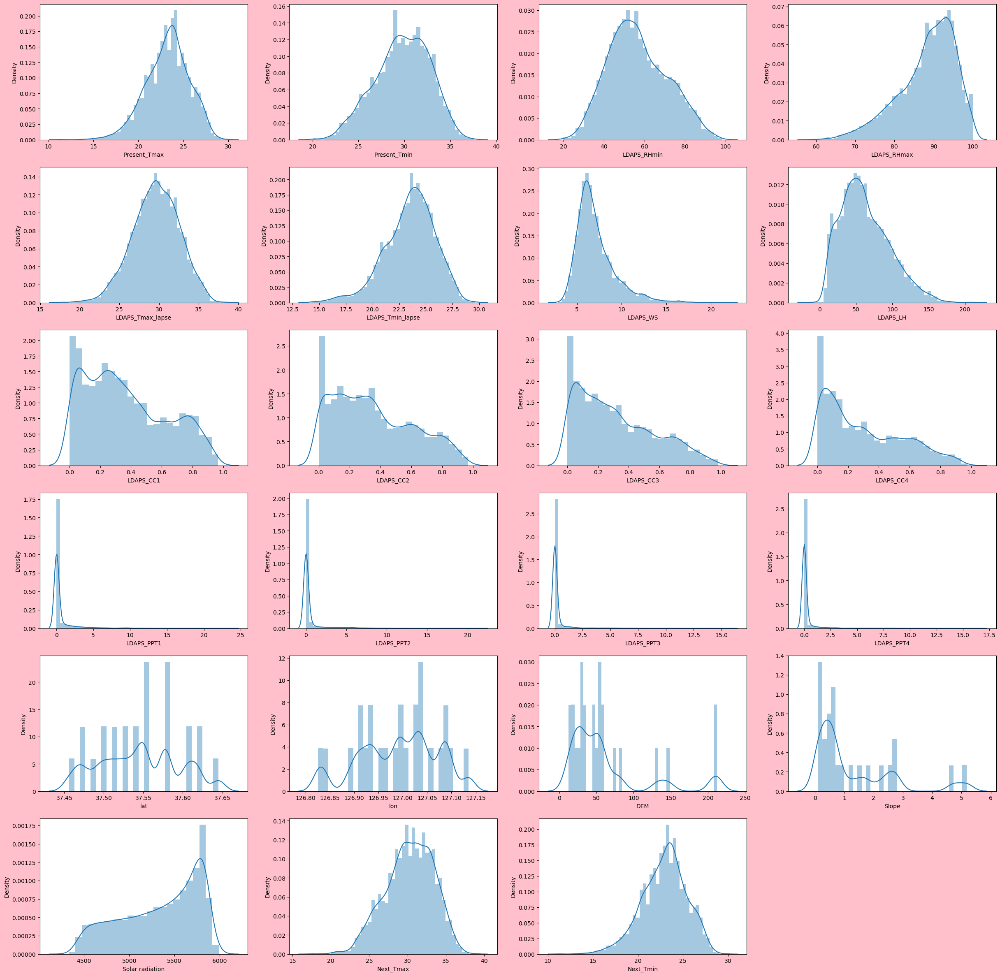

In [34]:
plt.figure(figsize=(30, 30), facecolor="pink")
plotnumber = 1
for i in df1.columns: 
    ax = plt.subplot(6, 4, plotnumber)  
    sns.distplot(df1[i])
    ax.set_xlabel(i)
    plotnumber += 1

plt.show()


In [35]:
df.skew()

station            -0.001634
Present_Tmax       -0.260032
Present_Tmin       -0.299531
LDAPS_RHmin         0.314010
LDAPS_RHmax        -0.735835
LDAPS_Tmax_lapse   -0.123992
LDAPS_Tmin_lapse   -0.415770
LDAPS_WS            1.122934
LDAPS_LH            0.584129
LDAPS_CC1           0.580686
LDAPS_CC2           0.498963
LDAPS_CC3           0.691823
LDAPS_CC4           0.704547
LDAPS_PPT1          3.735826
LDAPS_PPT2          4.786396
LDAPS_PPT3          5.494712
LDAPS_PPT4          5.923964
lat                 0.101313
lon                -0.275117
DEM                 1.748151
Slope               1.588965
Solar radiation    -0.512445
Next_Tmax          -0.286779
Next_Tmin          -0.271703
dtype: float64

here we can see that some of the features are skewed so we will remove the skewness

In [36]:
df['LDAPS_WS']=np.cbrt(df['LDAPS_WS'])
df['DEM']=np.cbrt(df['DEM'])
df['Slope']=np.cbrt(df['Slope'])


In [37]:
df['LDAPS_PPT1']=np.cbrt(df['LDAPS_PPT1'])
df['LDAPS_PPT2']=np.cbrt(df['LDAPS_PPT2'])
df['LDAPS_PPT3']=np.cbrt(df['LDAPS_PPT3'])
df['LDAPS_PPT4']=np.cbrt(df['LDAPS_PPT4'])

In [38]:
df.skew()

station            -0.001634
Present_Tmax       -0.260032
Present_Tmin       -0.299531
LDAPS_RHmin         0.314010
LDAPS_RHmax        -0.735835
LDAPS_Tmax_lapse   -0.123992
LDAPS_Tmin_lapse   -0.415770
LDAPS_WS            0.641453
LDAPS_LH            0.584129
LDAPS_CC1           0.580686
LDAPS_CC2           0.498963
LDAPS_CC3           0.691823
LDAPS_CC4           0.704547
LDAPS_PPT1          1.839561
LDAPS_PPT2          2.244620
LDAPS_PPT3          2.369354
LDAPS_PPT4          2.683632
lat                 0.101313
lon                -0.275117
DEM                 0.931195
Slope               0.622102
Solar radiation    -0.512445
Next_Tmax          -0.286779
Next_Tmin          -0.271703
dtype: float64

In [39]:
df['LDAPS_PPT1']=np.sqrt(df['LDAPS_PPT1'])
df['LDAPS_PPT2']=np.sqrt(df['LDAPS_PPT2'])
df['LDAPS_PPT3']=np.sqrt(df['LDAPS_PPT3'])
df['LDAPS_PPT4']=np.sqrt(df['LDAPS_PPT4'])

In [40]:
df.skew()

station            -0.001634
Present_Tmax       -0.260032
Present_Tmin       -0.299531
LDAPS_RHmin         0.314010
LDAPS_RHmax        -0.735835
LDAPS_Tmax_lapse   -0.123992
LDAPS_Tmin_lapse   -0.415770
LDAPS_WS            0.641453
LDAPS_LH            0.584129
LDAPS_CC1           0.580686
LDAPS_CC2           0.498963
LDAPS_CC3           0.691823
LDAPS_CC4           0.704547
LDAPS_PPT1          1.164943
LDAPS_PPT2          1.402564
LDAPS_PPT3          1.485498
LDAPS_PPT4          1.815010
lat                 0.101313
lon                -0.275117
DEM                 0.931195
Slope               0.622102
Solar radiation    -0.512445
Next_Tmax          -0.286779
Next_Tmin          -0.271703
dtype: float64

In [41]:
df['LDAPS_PPT1'] = np.cbrt(df['LDAPS_PPT1'])
df['LDAPS_PPT2'] = np.cbrt(df['LDAPS_PPT2'])
df['LDAPS_PPT3'] = np.cbrt(df['LDAPS_PPT3'])
df['LDAPS_PPT4'] = np.cbrt(df['LDAPS_PPT4'])

In [42]:
df.skew()

station            -0.001634
Present_Tmax       -0.260032
Present_Tmin       -0.299531
LDAPS_RHmin         0.314010
LDAPS_RHmax        -0.735835
LDAPS_Tmax_lapse   -0.123992
LDAPS_Tmin_lapse   -0.415770
LDAPS_WS            0.641453
LDAPS_LH            0.584129
LDAPS_CC1           0.580686
LDAPS_CC2           0.498963
LDAPS_CC3           0.691823
LDAPS_CC4           0.704547
LDAPS_PPT1          0.719556
LDAPS_PPT2          0.941071
LDAPS_PPT3          1.042021
LDAPS_PPT4          1.385430
lat                 0.101313
lon                -0.275117
DEM                 0.931195
Slope               0.622102
Solar radiation    -0.512445
Next_Tmax          -0.286779
Next_Tmin          -0.271703
dtype: float64

In [43]:
df['LDAPS_PPT3'] = np.sqrt(df['LDAPS_PPT3'])
df['LDAPS_PPT4'] = np.cbrt(df['LDAPS_PPT4'])

In [44]:
df.skew()

station            -0.001634
Present_Tmax       -0.260032
Present_Tmin       -0.299531
LDAPS_RHmin         0.314010
LDAPS_RHmax        -0.735835
LDAPS_Tmax_lapse   -0.123992
LDAPS_Tmin_lapse   -0.415770
LDAPS_WS            0.641453
LDAPS_LH            0.584129
LDAPS_CC1           0.580686
LDAPS_CC2           0.498963
LDAPS_CC3           0.691823
LDAPS_CC4           0.704547
LDAPS_PPT1          0.719556
LDAPS_PPT2          0.941071
LDAPS_PPT3          0.987240
LDAPS_PPT4          1.321709
lat                 0.101313
lon                -0.275117
DEM                 0.931195
Slope               0.622102
Solar radiation    -0.512445
Next_Tmax          -0.286779
Next_Tmin          -0.271703
dtype: float64

here we removed the skewness

### checking for correlation 

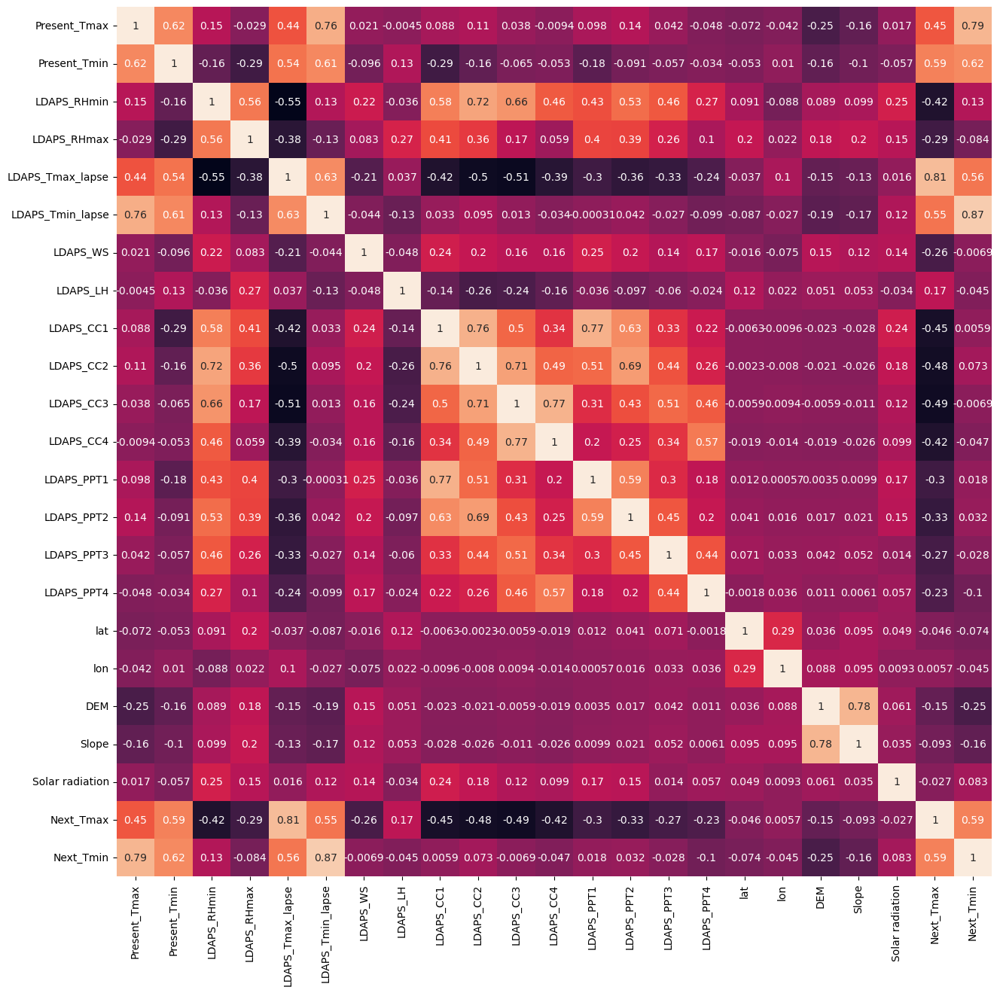

In [46]:
correlation = df.corr()
plt.figure(figsize=(15,15))
sns.heatmap(correlation , annot = True,cbar=False)
plt.show()

here we can see in our correlation heatmap that Present_Tmax,Present_Tmin,LDAPS_Tmax_lapse,LDAPS_Tmax_lapse,LDAPS_LH,Ion, Next_Tmin has positive correlation with the target variable 'Next_Tmax' and all other has negative correlation


Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_Tmax_lapse,LDAPS_Tmax_lapse,LDAPS_CC1,LDAPS_CC2,LDAPS_PPT1,LDAPS_PPT2,Solar radiation, Next_Tmax has positive correlation with the target variable 'Next_Tmin' and all other has negative correlation.

all the features  look moderately correalted but we will check further later

### --Using Label Encoder

In [47]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
for column in df.columns:
    if df[column].dtype == 'object':
        df[column] = label_encoder.fit_transform(df[column])


In [48]:
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,0,2013-06-30,21.4,28.7,58.255688,91.116364,28.074101,23.006936,1.896289,69.451805,...,0.0,0.0,0.0,37.6046,126.991,5.965871,1.406938,5992.895996,29.1,21.2
1,1,2013-06-30,21.6,31.9,52.263397,90.604721,29.850689,24.035009,1.785468,51.937448,...,0.0,0.0,0.0,37.6046,127.032,3.550622,0.801092,5869.312500,30.5,22.5
2,2,2013-06-30,23.3,31.6,48.690479,83.973587,30.091292,24.565633,1.830969,20.573050,...,0.0,0.0,0.0,37.5776,127.058,3.217444,0.643203,5863.555664,31.1,23.9
3,3,2013-06-30,23.4,32.0,58.239788,96.483688,29.704629,23.326177,1.781083,65.727144,...,0.0,0.0,0.0,37.6450,127.022,3.575659,1.363477,5856.964844,31.7,24.3
4,4,2013-06-30,21.9,31.4,56.174095,90.155128,29.113934,23.486480,1.789965,107.965535,...,0.0,0.0,0.0,37.5507,127.135,3.272250,0.796600,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6984,20,2017-08-30,17.8,23.1,24.688997,78.261383,27.812697,18.303014,1.876086,9.614074,...,0.0,0.0,0.0,37.5507,127.040,2.973771,0.830151,4456.024414,27.6,17.7
6985,21,2017-08-30,17.4,22.5,30.094858,83.690018,26.704905,17.814038,1.793400,82.146707,...,0.0,0.0,0.0,37.5102,127.086,2.800629,0.510703,4441.803711,28.0,17.1
6986,22,2017-08-30,17.1,23.3,26.741310,78.869858,26.352081,18.775678,1.832031,72.058294,...,0.0,0.0,0.0,37.5372,126.891,2.498004,0.537630,4443.313965,28.3,18.1
6987,23,2017-08-30,17.7,23.3,24.040634,77.294975,27.010193,18.733519,1.870345,47.241457,...,0.0,0.0,0.0,37.5237,126.909,2.586099,0.605778,4438.373535,28.6,18.8


### Seperating features and target variable('Next_Tmax')

In [50]:
X=  df.drop(['Date','Next_Tmax'], axis = 1)
Y=df['Next_Tmax'] 

### Scaling using Standard Scalar

In [51]:
from sklearn.preprocessing import StandardScaler
SS = StandardScaler()
X = pd.DataFrame(SS.fit_transform(X), columns = X.columns)
X

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin
0,-1.670832,-0.810477,-0.424770,0.185705,0.435759,-0.642547,-0.275281,0.047631,0.227477,-0.451896,...,-0.722055,-0.650533,-0.625277,-0.539141,1.212609,0.001728,2.349428,1.289908,1.542944,-0.775248
1,-1.532037,-0.724769,0.685069,-0.244766,0.363196,0.000489,0.183420,-0.630845,-0.298591,-0.485404,...,-0.722055,-0.650533,-0.625277,-0.539141,1.212609,0.518034,-0.140744,-0.417573,1.249995,-0.231532
2,-1.393243,0.003740,0.581022,-0.501435,-0.577258,0.087575,0.420171,-0.352279,-1.240664,-0.549586,...,-0.722055,-0.650533,-0.625277,-0.539141,0.672212,0.845448,-0.484258,-0.862558,1.236349,0.354007
3,-1.254449,0.046594,0.719752,0.184563,1.196974,-0.052378,-0.132844,-0.657695,0.115602,-0.521680,...,-0.722055,-0.650533,-0.625277,-0.539141,2.021204,0.392106,-0.114931,1.167420,1.220725,0.521304
4,-1.115655,-0.596209,0.511657,0.036169,0.299433,-0.266179,-0.061321,-0.603314,1.384290,-0.779627,...,-0.722055,-0.650533,-0.625277,-0.539141,0.133815,1.815096,-0.427752,-0.430233,1.226859,-0.231532
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6984,1.105050,-2.353203,-2.366987,-2.225641,-1.387385,-0.737162,-2.374056,-0.076059,-1.569832,-1.170744,...,-0.722055,-0.650533,-0.625277,-0.539141,0.133815,0.618777,-0.735489,-0.335674,-2.100142,-2.239097
6985,1.243845,-2.524617,-2.575082,-1.837298,-0.617475,-1.138127,-2.592225,-0.582285,0.608786,-1.116908,...,-0.722055,-0.650533,-0.625277,-0.539141,-0.676781,1.198047,-0.914003,-1.235990,-2.133851,-2.490042
6986,1.382639,-2.653178,-2.297623,-2.078208,-1.301089,-1.265832,-2.163165,-0.345773,0.305766,-1.261543,...,-0.722055,-0.650533,-0.625277,-0.539141,-0.136383,-1.257556,-1.226016,-1.160099,-2.130271,-2.071800
6987,1.521433,-2.396057,-2.297623,-2.272218,-1.524445,-1.027628,-2.181975,-0.111207,-0.439641,-1.238356,...,-0.722055,-0.650533,-0.625277,-0.539141,-0.406582,-1.030885,-1.135187,-0.968036,-2.141983,-1.779030


### checking for Variance Inflation Factor

In [53]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X.columns
vif['VIF values'] = [variance_inflation_factor(X.values,i)for i in range(len(X.columns))]
vif
                                                                         

,Features,VIF values
0,station,1.249023
1,Present_Tmax,3.329481
2,Present_Tmin,2.777584
3,LDAPS_RHmin,5.966155
4,LDAPS_RHmax,2.250509
5,LDAPS_Tmax_lapse,6.793881
6,LDAPS_Tmin_lapse,8.482211
7,LDAPS_WS,1.193900
8,LDAPS_LH,1.518873
9,LDAPS_CC1,5.232019


here we can see that all the features have moderate VIF so we there is no multicollinearity

## Creating train test Split

In [54]:
from sklearn.model_selection import train_test_split
for i in range(1,100):
    X_train,X_test,Y_train,Y_test =train_test_split (X,Y, test_size = 0.25 , random_state = i)

In [55]:
from sklearn.linear_model import LinearRegression,Ridge,Lasso
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor 
LR = LinearRegression()
RIG= Ridge()
SVM=SVR()
LS= Lasso()
RFR=RandomForestRegressor()
DTR = DecisionTreeRegressor()
abr = AdaBoostRegressor()
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import GridSearchCV

## Models

#### Lasso

In [56]:
LS.fit(X_train, Y_train)
y_pred = LS.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.5397840704431758


In [57]:
y_pred_testLS  = LS.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testLS ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.555509684295119


In [58]:
mae = mean_absolute_error(Y_test, y_pred_testLS)
mse = mean_squared_error(Y_test, y_pred_testLS)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 1.5639271488399673
Mean Squared Error -->: 3.8932681582281448
Root Mean Squared Error-->: 1.9731366293868615


#### Ridge

In [59]:
RIG.fit(X_train, Y_train)
y_pred = RIG.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.7799704124295391


In [60]:
y_pred_testRIG  = RIG.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testRIG ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.7701212265735565


In [61]:
mae = mean_absolute_error(Y_test, y_pred_testRIG)
mse = mean_squared_error(Y_test, y_pred_testRIG)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 1.0779820480343685
Mean Squared Error -->: 2.0134965312223714
Root Mean Squared Error-->: 1.4189772835469818


#### Support vector model (svm)

In [62]:
SVM.fit(X_train, Y_train)
y_pred = SVM.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.8898446300772153


In [63]:
y_pred_testSVM  = SVM.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testSVM ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.8652622002881601


In [64]:
mae = mean_absolute_error(Y_test, y_pred_testSVM)
mse = mean_squared_error(Y_test, y_pred_testSVM)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.781117011689564
Mean Squared Error -->: 1.1801615621162727
Root Mean Squared Error-->: 1.0863524115664642


#### Linear Regression

In [65]:
LR.fit(X_train, Y_train)
y_pred = LR.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.7799705960496285


In [66]:
y_pred_testLR  = LR.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testLR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.7700865331771107


In [67]:
mae = mean_absolute_error(Y_test, y_pred_testLR)
mse = mean_squared_error(Y_test, y_pred_testLR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 1.0780849956963674
Mean Squared Error -->: 2.013800408924339
Root Mean Squared Error-->: 1.4190843558169257


#### DecisionTreeRegressor

In [68]:
DTR.fit(X_train, Y_train)
y_pred = DTR.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 1.0


In [69]:
y_pred_testDTR  = DTR.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testDTR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.770118087357138


In [70]:
mae = mean_absolute_error(Y_test, y_pred_testDTR)
mse = mean_squared_error(Y_test, y_pred_testDTR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 1.024141876430206
Mean Squared Error -->: 2.0135240274599537
Root Mean Squared Error-->: 1.4189869722657618


#### AdaBoost Regressor

In [71]:
abr.fit(X_train, Y_train)
y_pred = abr.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.7740250340430003


In [72]:
y_pred_testABR  = abr.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testABR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.755296597052793


In [73]:
mae = mean_absolute_error(Y_test, y_pred_testABR)
mse = mean_squared_error(Y_test, y_pred_testABR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 1.1676293421525794
Mean Squared Error -->: 2.1433447102073075
Root Mean Squared Error-->: 1.464016635905244


#### Random Forest Regressor

In [74]:
RFR.fit(X_train, Y_train)
y_pred = RFR.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.9850309664749348


In [75]:
y_pred_testRFR  = RFR.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testRFR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.8935266224858402


In [76]:
mae = mean_absolute_error(Y_test, y_pred_testRFR)
mse = mean_squared_error(Y_test, y_pred_testRFR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.7225812356979403
Mean Squared Error -->: 0.9325949199084669
Root Mean Squared Error-->: 0.9657095422063856


we will further check that which model to use by using the cross validation 

## Cross Validation

In [77]:
from sklearn.model_selection import cross_val_score

In [78]:
cscore1 = cross_val_score(LS,X,Y)
print('Cscore for Lasso-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testLS)-cscore1.mean())

Cscore for Lasso->  [0.47505168 0.47603213 0.56024641 0.39218374 0.53814559]
mean of cscore->  0.4883319096930073
difference between R2 and cross validation score is 0.06717777460211172


In [79]:
cscore1 = cross_val_score(abr,X,Y)
print('Cscore for AdaBoost Regressor-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testABR)-cscore1.mean())

Cscore for AdaBoost Regressor->  [0.68248782 0.62086792 0.62336505 0.70414693 0.62243629]
mean of cscore->  0.6506608011159163
difference between R2 and cross validation score is 0.10463579593687666


In [80]:
cscore1 = cross_val_score(LR,X,Y)
print('Cscore for Linaer Regression -> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testLR)-cscore1.mean())

Cscore for Linaer Regression ->  [0.72224088 0.65715523 0.70011506 0.76751237 0.6959835 ]
mean of cscore->  0.7086014074267173
difference between R2 and cross validation score is 0.06148512575039344


In [81]:
cscore1 = cross_val_score(RIG,X,Y)
print('Cscore for RIDGE-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testRIG)-cscore1.mean())

Cscore for RIDGE->  [0.72239588 0.65714698 0.70008566 0.7675302  0.69601747]
mean of cscore->  0.7086352380021997
difference between R2 and cross validation score is 0.06148598857135679


In [82]:
cscore1 = cross_val_score(SVM,X,Y)
print('Cscore for Support Vector Model -> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testABR)-cscore1.mean())

Cscore for Support Vector Model ->  [0.68378798 0.5752632  0.67819467 0.77314667 0.66986547]
mean of cscore->  0.6760515953727241
difference between R2 and cross validation score is 0.07924500168006887


In [83]:
cscore1 = cross_val_score(DTR,X,Y)
print('Cscore for Decision Tree Regressor -> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testDTR)-cscore1.mean())

Cscore for Decision Tree Regressor ->  [0.43760407 0.41627789 0.4152892  0.54187529 0.4930889 ]
mean of cscore->  0.46082707031755954
difference between R2 and cross validation score is 0.3092910170395785


In [84]:
cscore1 = cross_val_score(RFR,X,Y)
print('Cscore for RandomForest Regressor-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testRFR)-cscore1.mean())

Cscore for RandomForest Regressor->  [0.71828528 0.65836383 0.6703383  0.73408555 0.66080008]
mean of cscore->  0.6883746097507674
difference between R2 and cross validation score is 0.2051520127350729


here based on cross validation score we choose Linear Regression

## Hyper parameter tuning

In [85]:
LR.get_params().keys()

dict_keys(['copy_X', 'fit_intercept', 'n_jobs', 'normalize', 'positive'])

In [88]:
parameters = {
    'fit_intercept': [True, False],
    'normalize': [True, False],
    'copy_X': [True, False],
    'n_jobs': [None, 1, 2],  
}


In [89]:
GSC = GridSearchCV(LinearRegression(),parameters,cv= 5)

In [90]:
GSC.fit(X_train,Y_train)

GridSearchCV(cv=5, estimator=LinearRegression(),
             param_grid={'copy_X': [True, False],
                         'fit_intercept': [True, False], 'n_jobs': [None, 1, 2],
                         'normalize': [True, False]})

In [91]:
GSC.best_params_ 

{'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'normalize': True}

In [93]:
LR_final=LinearRegression(copy_X= True, fit_intercept= True, n_jobs= None, normalize= True)
LR_final.fit(X_train, Y_train)
y_pred = LR_final.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.7799705960496284


In [94]:
y_pred_testLR  = LR_final.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testLR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.7700865331771107


## Model Saving

In [99]:
import joblib
joblib.dump(LR_final, 'Temperature Next_Tmax')

['Temperature Next_Tmax']

# Prediction 

In [100]:
mymodel = joblib.load('Temperature Next_Tmax')
prdt = mymodel.predict(X_test)
prdt

array([27.55173802, 28.21594274, 30.89100727, ..., 27.41472931,
       28.30704513, 31.42202739])

## comparing from original 

In [101]:
Orginal = np.array(Y_test)
data1 = pd.DataFrame({'predicted': prdt,'original':Orginal})
data1

,predicted,original
0,27.551738,27.7
1,28.215943,28.1
2,30.891007,30.4
3,25.059686,26.1
4,36.185832,36.2
...,...,...
1743,33.273058,34.7
1744,31.939415,31.5
1745,27.414729,26.9
1746,28.307045,29.3


hence we can see that our model approximately predicted most of the values  

### Seperating features and target variable('Next_Tmin')

In [103]:
X=  df.drop(['Date','Next_Tmin'], axis = 1)
Y=df['Next_Tmin'] 

### Scaling using Standard Scalar

In [104]:
from sklearn.preprocessing import StandardScaler
SS = StandardScaler()
X = pd.DataFrame(SS.fit_transform(X), columns = X.columns)
X

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,-1.670832,-0.810477,-0.424770,0.185705,0.435759,-0.642547,-0.275281,0.047631,0.227477,-0.451896,...,-0.722055,-0.650533,-0.625277,-0.539141,1.212609,0.001728,2.349428,1.289908,1.542944,-0.476941
1,-1.532037,-0.724769,0.685069,-0.244766,0.363196,0.000489,0.183420,-0.630845,-0.298591,-0.485404,...,-0.722055,-0.650533,-0.625277,-0.539141,1.212609,0.518034,-0.140744,-0.417573,1.249995,-0.006092
2,-1.393243,0.003740,0.581022,-0.501435,-0.577258,0.087575,0.420171,-0.352279,-1.240664,-0.549586,...,-0.722055,-0.650533,-0.625277,-0.539141,0.672212,0.845448,-0.484258,-0.862558,1.236349,0.195700
3,-1.254449,0.046594,0.719752,0.184563,1.196974,-0.052378,-0.132844,-0.657695,0.115602,-0.521680,...,-0.722055,-0.650533,-0.625277,-0.539141,2.021204,0.392106,-0.114931,1.167420,1.220725,0.397492
4,-1.115655,-0.596209,0.511657,0.036169,0.299433,-0.266179,-0.061321,-0.603314,1.384290,-0.779627,...,-0.722055,-0.650533,-0.625277,-0.539141,0.133815,1.815096,-0.427752,-0.430233,1.226859,0.229332
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6984,1.105050,-2.353203,-2.366987,-2.225641,-1.387385,-0.737162,-2.374056,-0.076059,-1.569832,-1.170744,...,-0.722055,-0.650533,-0.625277,-0.539141,0.133815,0.618777,-0.735489,-0.335674,-2.100142,-0.981421
6985,1.243845,-2.524617,-2.575082,-1.837298,-0.617475,-1.138127,-2.592225,-0.582285,0.608786,-1.116908,...,-0.722055,-0.650533,-0.625277,-0.539141,-0.676781,1.198047,-0.914003,-1.235990,-2.133851,-0.846893
6986,1.382639,-2.653178,-2.297623,-2.078208,-1.301089,-1.265832,-2.163165,-0.345773,0.305766,-1.261543,...,-0.722055,-0.650533,-0.625277,-0.539141,-0.136383,-1.257556,-1.226016,-1.160099,-2.130271,-0.745997
6987,1.521433,-2.396057,-2.297623,-2.272218,-1.524445,-1.027628,-2.181975,-0.111207,-0.439641,-1.238356,...,-0.722055,-0.650533,-0.625277,-0.539141,-0.406582,-1.030885,-1.135187,-0.968036,-2.141983,-0.645101


### Checking for VIF

In [105]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['VIF values'] = [variance_inflation_factor(X.values,i)for i in range(len(X.columns))]
vif['Features'] = X.columns
vif
                                                                         

,VIF values,Features
0,1.258992,station
1,3.037330,Present_Tmax
2,2.854360,Present_Tmin
3,5.929795,LDAPS_RHmin
4,2.252143,LDAPS_RHmax
5,8.013222,LDAPS_Tmax_lapse
6,6.727513,LDAPS_Tmin_lapse
7,1.219316,LDAPS_WS
8,1.547034,LDAPS_LH
9,5.246842,LDAPS_CC1


here we can see that no features have high VIF so there is no problem of multicollinearity

## creating train test split

In [106]:
from sklearn.model_selection import train_test_split
for i in range(1,100):
    X_train,X_test,Y_train,Y_test =train_test_split (X,Y, test_size = 0.25 , random_state = i)

#### importing necessary libraries for models

In [107]:
from sklearn.linear_model import LinearRegression,Ridge,Lasso
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor 
LR = LinearRegression()
RIG= Ridge()
SVM=SVR()
LS= Lasso()
RFR=RandomForestRegressor()
DTR = DecisionTreeRegressor()
abr = AdaBoostRegressor()
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import GridSearchCV

## Models

#### Lasso

In [108]:
LS.fit(X_train, Y_train)
y_pred = LS.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.5936897874860678


In [109]:
y_pred_testLS  = LS.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testLS ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.5987510045318212


In [110]:
mae = mean_absolute_error(Y_test, y_pred_testLS)
mse = mean_squared_error(Y_test, y_pred_testLS)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 1.2288770911927
Mean Squared Error -->: 2.338014893426314
Root Mean Squared Error-->: 1.5290568640264213


#### Ridge

In [111]:
RIG.fit(X_train, Y_train)
y_pred = RIG.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.8412253010827795


In [112]:
y_pred_testRIG  = RIG.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testRIG ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.8324361593220697


In [113]:
mae = mean_absolute_error(Y_test, y_pred_testRIG)
mse = mean_squared_error(Y_test, y_pred_testRIG)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.7791410670238852
Mean Squared Error -->: 0.9763681891529729
Root Mean Squared Error-->: 0.988113449535514


#### Support vector Regression (svm)

In [114]:
SVM.fit(X_train, Y_train)
y_pred = SVM.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.9304842262763735


In [115]:
y_pred_testSVM  = SVM.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testSVM ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.9036285449284769


In [116]:
mae = mean_absolute_error(Y_test, y_pred_testSVM)
mse = mean_squared_error(Y_test, y_pred_testSVM)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.5690575457289924
Mean Squared Error -->: 0.5615413366841812
Root Mean Squared Error-->: 0.7493606185837238


#### LInear Regression

In [117]:
LR.fit(X_train, Y_train)
y_pred = LR.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.8412253981624689


In [118]:
y_pred_testLR  = LR.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testLR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.8324240305285749


In [119]:
mae = mean_absolute_error(Y_test, y_pred_testLR)
mse = mean_squared_error(Y_test, y_pred_testLR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.7791641778033818
Mean Squared Error -->: 0.9764388617282325
Root Mean Squared Error-->: 0.9881492102553301


#### DecisionTreeRegressor 

In [120]:
DTR.fit(X_train, Y_train)
y_pred = DTR.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 1.0


In [121]:
y_pred_testDTR  = DTR.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testDTR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.7554166560295092


In [122]:
mae = mean_absolute_error(Y_test, y_pred_testDTR)
mse = mean_squared_error(Y_test, y_pred_testDTR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.8786041189931351
Mean Squared Error -->: 1.4251487414187642
Root Mean Squared Error-->: 1.1937959379302496


#### AdaBoostRegressor

In [123]:
abr.fit(X_train, Y_train)
y_pred = abr.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.8175162882259394


In [124]:
y_pred_testABR  = abr.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testABR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.8080644650631855


In [125]:
mae = mean_absolute_error(Y_test, y_pred_testABR)
mse = mean_squared_error(Y_test, y_pred_testABR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.8554743139936696
Mean Squared Error -->: 1.1183782248137915
Root Mean Squared Error-->: 1.0575340300972784


#### RandoForestRegressor 

In [126]:
RFR.fit(X_train, Y_train)
y_pred = RFR.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.9862908541405716


In [127]:
y_pred_testRFR  = RFR.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testRFR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.9070460229541389


In [128]:
mae = mean_absolute_error(Y_test, y_pred_testRFR)
mse = mean_squared_error(Y_test, y_pred_testRFR)
rmse = np.sqrt(mse)

print("Mean Absolute Error-->", mae)
print("Mean Squared Error -->:", mse)
print("Root Mean Squared Error-->:", rmse)

Mean Absolute Error--> 0.5632482837528606
Mean Squared Error -->: 0.5416282288329521
Root Mean Squared Error-->: 0.7359539583648913


we will further understand which model is best predicting by using cross validation 

## Cross Validation

In [129]:
from sklearn.model_selection import cross_val_score

In [130]:
cscore1 = cross_val_score(LS,X,Y)
print('Cscore for Lasso-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testLS)-cscore1.mean())

Cscore for Lasso->  [0.55229082 0.41477378 0.57124084 0.47121868 0.64315266]
mean of cscore->  0.5305353544599929
difference between R2 and cross validation score is 0.06821565007182828


In [131]:
cscore1 = cross_val_score(abr,X,Y)
print('Cscore for AdaBoost Regressor-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testABR)-cscore1.mean())

Cscore for AdaBoost Regressor->  [0.66842492 0.62526022 0.78515098 0.78807572 0.82549487]
mean of cscore->  0.7384813433548544
difference between R2 and cross validation score is 0.06958312170833114


In [132]:
cscore1 = cross_val_score(LR,X,Y)
print('Cscore for Linaer Regression -> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testLR)-cscore1.mean())

Cscore for Linaer Regression ->  [0.75759588 0.69034629 0.80104041 0.84801397 0.86633312]
mean of cscore->  0.7926659351134437
difference between R2 and cross validation score is 0.0397580954151312


In [133]:
cscore1 = cross_val_score(RIG,X,Y)
print('Cscore for RIDGE-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testRIG)-cscore1.mean())

Cscore for RIDGE->  [0.75763383 0.69038627 0.80102019 0.84803158 0.86635055]
mean of cscore->  0.7926844834224878
difference between R2 and cross validation score is 0.03975167589958195


In [134]:
cscore1 = cross_val_score(SVM,X,Y)
print('Cscore for Support Vector Model -> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testABR)-cscore1.mean())

Cscore for Support Vector Model ->  [0.66333981 0.66450407 0.7622375  0.82281786 0.84570225]
mean of cscore->  0.7517202974025501
difference between R2 and cross validation score is 0.056344167660635436


In [135]:
cscore1 = cross_val_score(DTR,X,Y)
print('Cscore for Decision Tree Regressor -> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testDTR)-cscore1.mean())

Cscore for Decision Tree Regressor ->  [0.4690589  0.49430863 0.66897061 0.73003881 0.66779259]
mean of cscore->  0.606033908975666
difference between R2 and cross validation score is 0.14938274705384325


In [136]:
cscore1 = cross_val_score(RFR,X,Y)
print('Cscore for RandomForest Regressor-> ',cscore1)
print('mean of cscore-> ',cscore1.mean())
print('difference between R2 and cross validation score is',r2_score(Y_test,y_pred_testRFR)-cscore1.mean())

Cscore for RandomForest Regressor->  [0.72878787 0.69953698 0.81873631 0.85468207 0.86296329]
mean of cscore->  0.7929413026570968
difference between R2 and cross validation score is 0.1141047202970421


here after considering the Cscore we we choose Linear Regression 

## Hyper parameter tuning

In [137]:
LR.get_params().keys()

dict_keys(['copy_X', 'fit_intercept', 'n_jobs', 'normalize', 'positive'])

In [138]:
parameters = {
    'fit_intercept': [True, False],
    'normalize': [True, False],
    'copy_X': [True, False],
    'n_jobs': [None, 1, 2],  
}


In [139]:
GSC = GridSearchCV(LinearRegression(),parameters,cv= 5)

In [140]:
GSC.fit(X_train,Y_train)

GridSearchCV(cv=5, estimator=LinearRegression(),
             param_grid={'copy_X': [True, False],
                         'fit_intercept': [True, False], 'n_jobs': [None, 1, 2],
                         'normalize': [True, False]})

In [141]:
GSC.best_params_ 

{'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'normalize': True}

In [144]:
LR_final=LinearRegression(copy_X= True, fit_intercept= True, n_jobs=1 , normalize= True)
LR_final.fit(X_train, Y_train)
y_pred = LR_final.predict(X_train)
R2_score = r2_score( Y_train,y_pred ) # checking train data 
print("r2 score of trained data--->",R2_score) 

r2 score of trained data---> 0.8412253981624689


In [145]:
y_pred_testLR  = LR_final.predict(X_test)
R2_score = r2_score( Y_test, y_pred_testLR ) # checking test data 
print('r2 score of test data--->', R2_score)

r2 score of test data---> 0.8324240305285749


## Model Saving and Predicition

In [146]:
joblib.dump(LR_final, 'Temperature Next_Tmax')
mymodel = joblib.load('Temperature Next_Tmax')
prdt = mymodel.predict(X_test)
prdt

array([21.77949737, 19.07842767, 22.29734005, ..., 20.9212138 ,
       24.88702199, 23.02447564])

## comparing from original 

In [147]:
Orginal = np.array(Y_test)
data1 = pd.DataFrame({'predicted': prdt,'original':Orginal})
data1

,predicted,original
0,21.779497,21.6
1,19.078428,17.9
2,22.297340,23.4
3,21.152012,20.3
4,27.094319,27.1
...,...,...
1743,24.508843,24.1
1744,20.947594,21.4
1745,20.921214,21.2
1746,24.887022,25.4


hence we can see that our model approximately predicted most of the values  